# All hematopoietic dataset

Hematopoiesis dataset from *Weinreb, C., Rodriguez-Fraticelli, A., Camargo, F. D. & Klein, A. M. Science 367, (2020)*. 

This dataset has 3 time points for both the clonal and state measurements. This dataset has ~50000 cells. Running the whole pipeline for the first time could take 5.2 hours in a standard personal computer.
Most of the time (3.3 h) is used for generating the similarity matrix, which are saved for later usage. It also generates output files that amount to 25G storage.

**Key components:**
    
* Part 1: Infer transition map using clones from both day 4 and day 6
    
* Part II: Infer transition map using clones from all time points
    
* Part III: Infer transition map using only clones from the last time point

In [3]:
import sys
import os
new_path=os.getcwd()+"/CoSpar/"
sys.path.append(new_path)

import cospar as cs
import numpy as np

In [7]:
cs.logging.print_version()
cs.settings.verbosity=2
cs.settings.data_path='LARRY_data' # A relative path to save data. If not existed before, create a new one.
cs.settings.figure_path='LARRY_figure' # A relative path to save figures. If not existed before, create a new one.
cs.settings.set_figure_params(format='png',figsize=[4,3.5],dpi=75,fontsize=14,pointsize=3) 

Running cospar 0.0.11 (python 3.6.12) on 2021-04-14 00:07.


## Load data

In [5]:
adata_orig=cs.datasets.hematopoiesis_all()

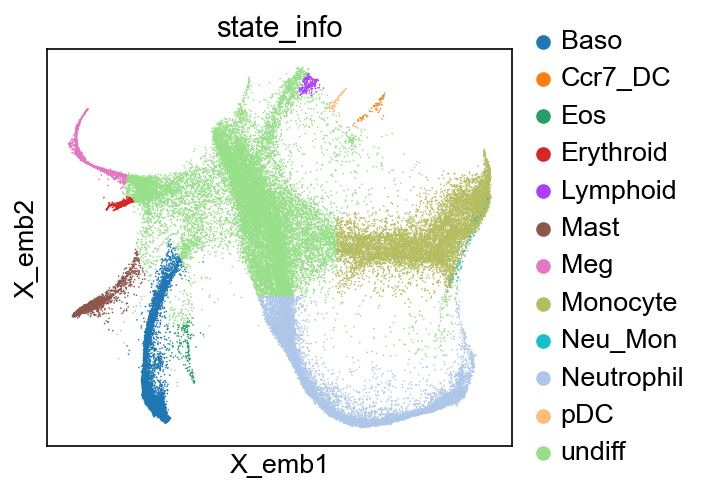

<Figure size 300x262.5 with 0 Axes>

In [6]:
cs.pl.embedding(adata_orig,color='state_info')

In [8]:
cs.hf.check_available_choices(adata_orig)

Current time ordering from simple sorting: ['2' '4' '6']
Available transition maps: []
Available clusters: ['Neutrophil', 'Ccr7_DC', 'Neu_Mon', 'Meg', 'Eos', 'Erythroid', 'Lymphoid', 'pDC', 'Baso', 'Mast', 'Monocyte', 'undiff']
Available time points: ['2' '4' '6']
Clonal time points: ['2' '4' '6']


In [9]:
adata_orig.obsm['X_clone']

<49116x5864 sparse matrix of type '<class 'numpy.bool_'>'
	with 49116 stored elements in Compressed Sparse Row format>

### Basic clonal analysis

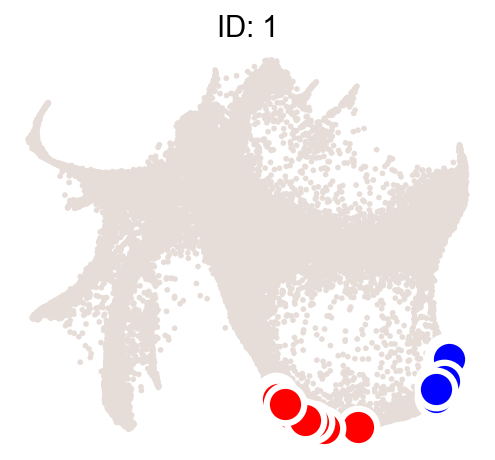

In [10]:
cs.pl.clones_on_manifold(adata_orig,selected_clone_list=[1],color_list=['black','red','blue'])

In [11]:
cs.settings.set_figure_params(fontsize=18,format='pdf')
selected_time_point='4'
selected_fates=['Ccr7_DC','Mast','Meg','pDC','Eos','Lymphoid','Erythroid','Baso',  'Neutrophil', 'Monocyte']
celltype_names=['mDC',  'Ma', 'Mk', 'pDC', 'Eos', 'Ly', 'Er', 'Ba', 'Neu', 'Mo']
coupling=cs.pl.fate_coupling_from_clones(adata_orig,selected_time_point, selected_fates=selected_fates, 
                color_bar=False,rename_selected_fates=celltype_names)

TypeError: fate_coupling_from_clones() got an unexpected keyword argument 'rename_selected_fates'

## Part 1: Infer transition map using clones from both day 4 and day 6

### Map inference

When first run, it takes 3 h 37 mins, in which 3 h 20 mins are used for computing the similarity matrices and saving these data. It takes only 20 mins for later runs.

Trying to set attribute `.uns` of view, copying.


----------Compute the full Similarity matrix if necessary---------
-----------------Infer transition map between initial time points and the later time one-----------------------
Current initial time point: 2
-------Step 1: Select time points---------
--> Clonal cell fraction (day 2-6): 0.3677208287895311
--> Clonal cell fraction (day 6-2): 0.30305387398965133
--> Numer of cells that are clonally related -- day 2: 1686  and day 6: 8961
Valid clone number 'FOR' post selection 1216
Cell number=34154, Clone number=1216
-------Step 2: Optimize the transition map recursively---------
---------Compute the transition map-----------
Compute similarity matrix: load existing data
--> Time elapsed:  0.8098342418670654
--> Time elapsed:  4.159980058670044
--> Time elapsed:  0.36036109924316406
--> Time elapsed:  2.381577968597412
Compute similarity matrix: load existing data
--> Time elapsed:  0.5885360240936279
--> Time elapsed:  2.973971128463745
--> Time elapsed:  0.22885918617248535
--> Time e

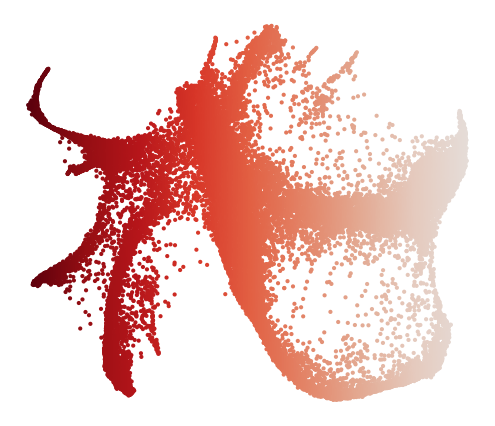

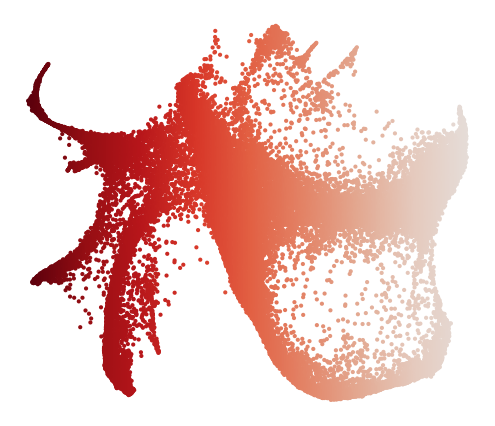

In [63]:
noise_threshold=0.1 # 
#selected_clonal_time_points=['2','4']
adata=cs.tmap.infer_Tmap_from_multitime_clones(adata_orig,later_time_point='6',smooth_array=[20,15,10],
        noise_threshold=noise_threshold,demulti_threshold=noise_threshold,extend_Tmap_space=False)

In [37]:
noise_threshold=0.1 # 
#selected_clonal_time_points=['2','4']
adata=cs.tmap.infer_intraclone_Tmap(adata,demulti_threshold=0.1)

KeyError: 'proportion'

### Save or load pre-computed data

In [48]:
save_data=False
if save_data:
    cs.hf.save_map(adata)
    
load_data=True
if load_data:### Plotting
    # updated Jan 27, 2021
    #data_des='LARRY_MultiTimeClone_0_t*2*4_extendedSpace'
    #data_des='LARRY_MultiTimeClone_Later_1_t*2*4*6'
    #data_des='LARRY_TwoTimeClone_t*4*6'### Plotting
    #data_des='LARRY_OneTimeClone_t*4*6'
    #data_des='LARRY_TwoTimeClone_t*2*4*6'
    #data_des='LARRY_StateInfo_t*4*6'
    #data_des='LARRY_StateInfo_SPD_t*4*6'
    #data_des='LARRY_WOT_t*24*6'
    data_des='LARRY_OneTimeClone_t*24*6'
    #data_des='LARRY_StateInfo_t*24*6'
    adata=cs.hf.load_saved_adata_with_key(data_des)


In [ ]:
cs.settings.set_figure_params(format='png',figsize=[4,3.5],dpi=200,fontsize=14,pointsize=2) 

In [49]:
adata.uns['data_des']

array(['LARRY', 'LARRY_OneTimeClone_t*24*6'], dtype=object)

### Plotting

#### Plotting transition profiles for single cells

In [56]:
cs.settings.set_figure_params(format='png',figsize=[4,3.5],dpi=75,fontsize=14,pointsize=5) 

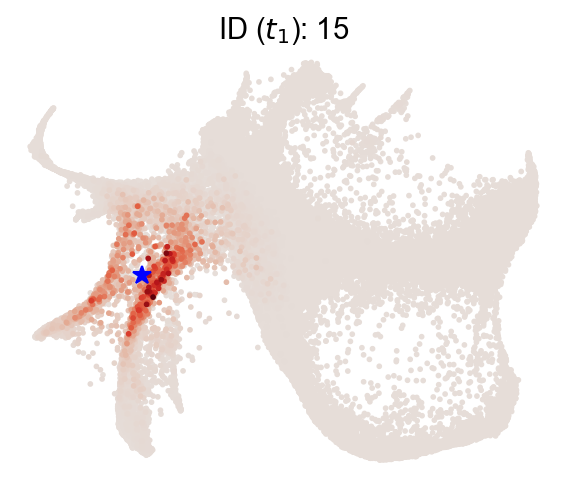

In [11]:
selected_state_id_list=[15]

cs.pl.single_cell_transition(adata,selected_state_id_list=selected_state_id_list, color_bar=False,
                used_Tmap='transition_map',map_backwards=False,savefig=True,initial_point_size=3)

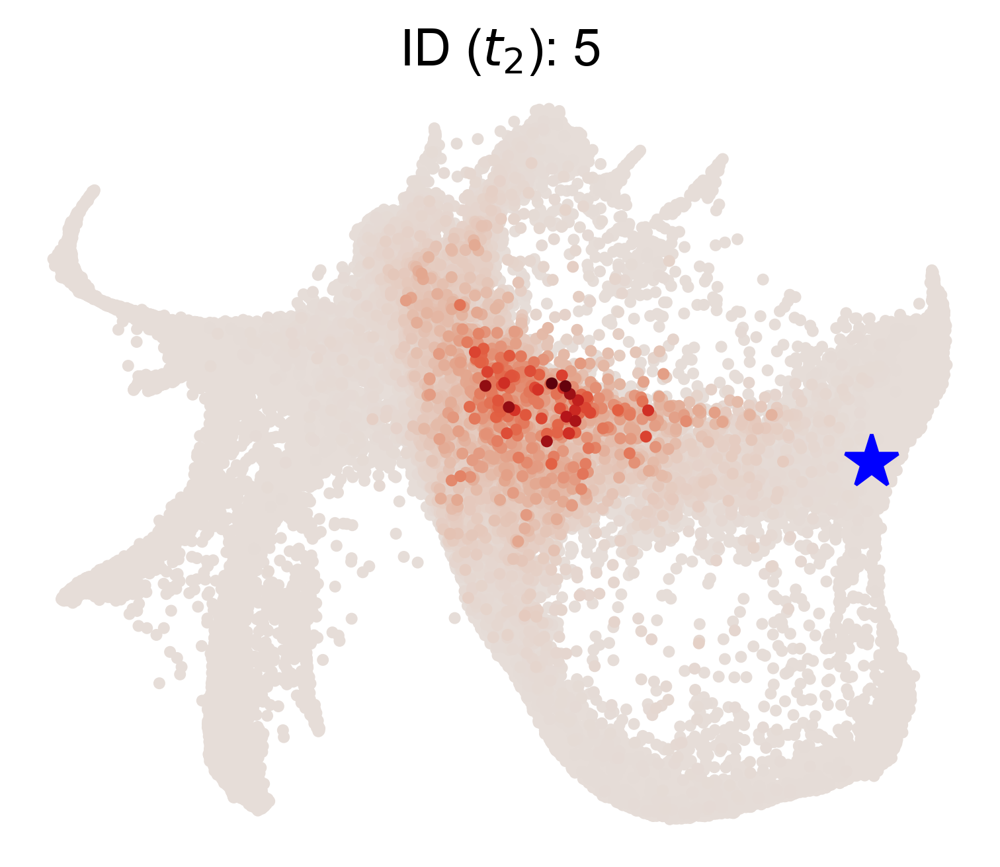

In [51]:
selected_state_id_list=[5]

cs.pl.single_cell_transition(adata,selected_state_id_list=selected_state_id_list, color_bar=False,
                used_Tmap='transition_map',map_backwards=True,savefig=True,initial_point_size=3)

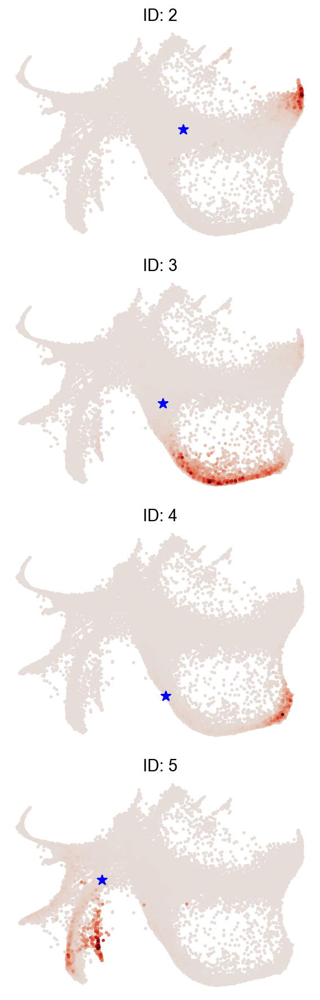

In [6]:
selected_state_id_list=[2,3]

cs.pl.single_cell_transition(adata,selected_state_id_list=selected_state_id_list, color_bar=False,
                                    used_Tmap='transition_map',map_backwards=False)

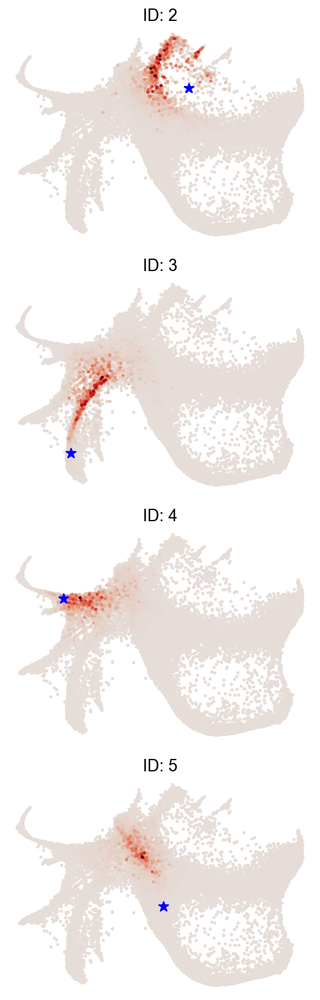

In [7]:
selected_state_id_list=[5]

cs.pl.single_cell_transition(adata,selected_state_id_list=selected_state_id_list, color_bar=False,
                                    used_Tmap='transition_map',map_backwards=True)

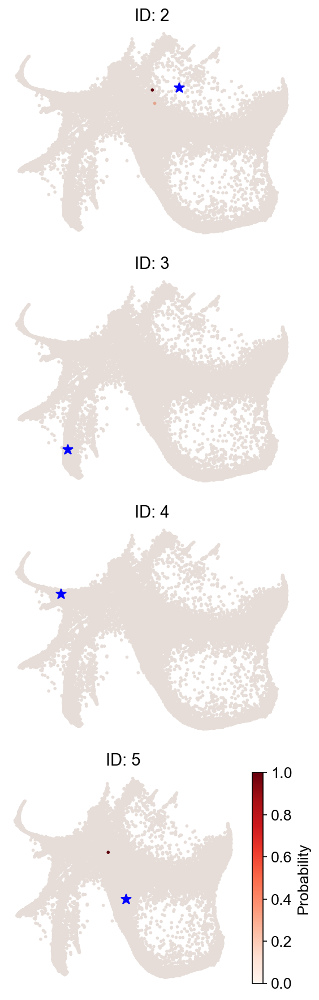

In [17]:
selected_state_id_list=[5]

cs.pl.single_cell_transition(adata,selected_state_id_list=selected_state_id_list, color_bar=True,
                                    used_Tmap='intraclone_transition_map',map_backwards=True)

#### Fate map

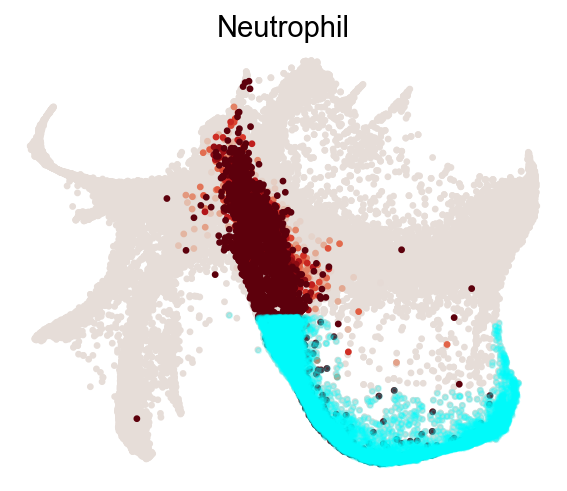

In [64]:
cs.pl.fate_map(adata,selected_fates=['Neutrophil'],
               used_Tmap='intraclone_transition_map',map_backwards=True,plot_target_state=True,color_bar=False)

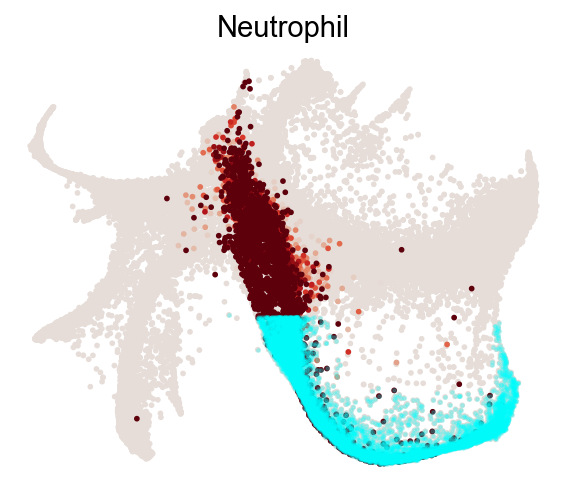

In [47]:
cs.pl.fate_map(adata,selected_fates=['Neutrophil'],
               used_Tmap='intraclone_transition_map',map_backwards=True,plot_target_state=True,color_bar=False)

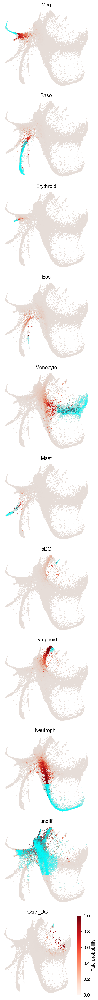

In [9]:
cs.pl.fate_map(adata,selected_fates=[],
               used_Tmap='transition_map',map_backwards=True,plot_target_state=True)

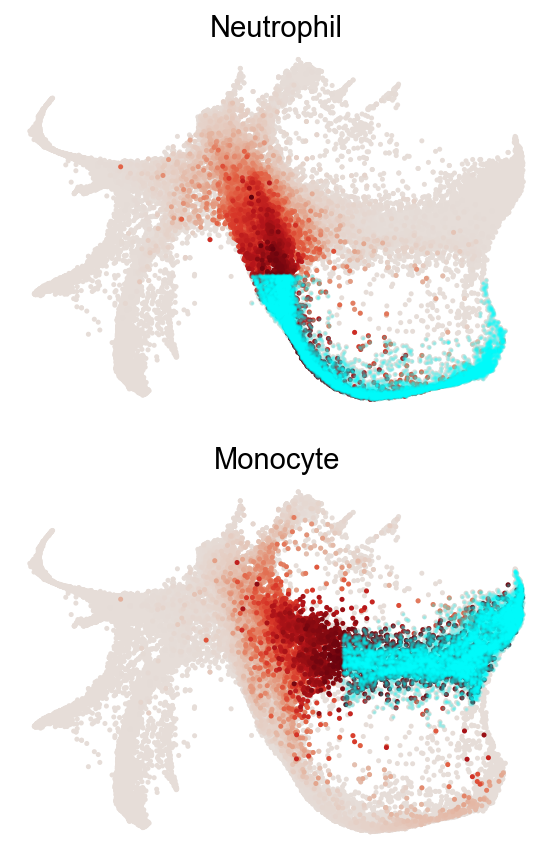

In [12]:
cs.pl.fate_map(adata,selected_fates=['Neutrophil','Monocyte'],color_bar=False,
               used_Tmap='transition_map',map_backwards=True,plot_target_state=True)

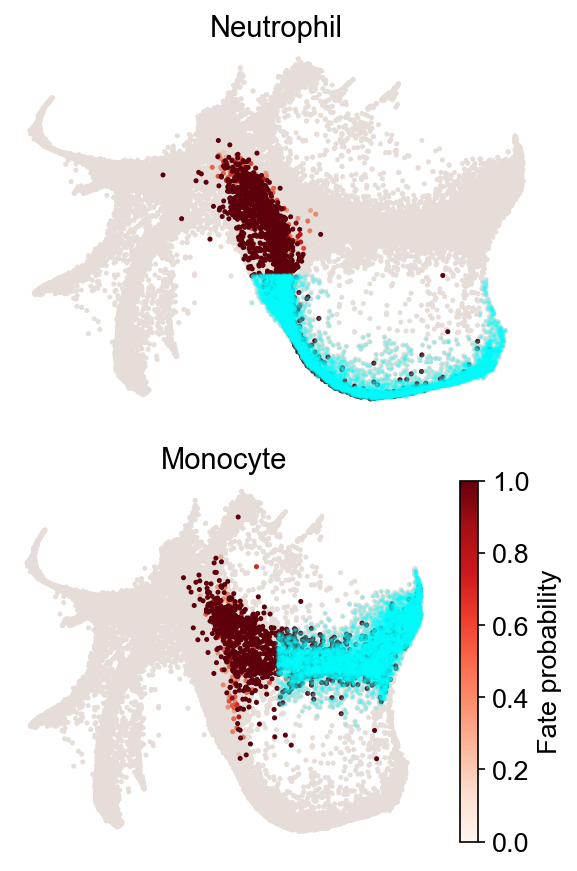

In [15]:
cs.pl.fate_map(adata,selected_fates=['Neutrophil','Monocyte'],color_bar=True,
               used_Tmap='intraclone_transition_map',map_backwards=True,plot_target_state=True)

#### Relative fate bias

4585


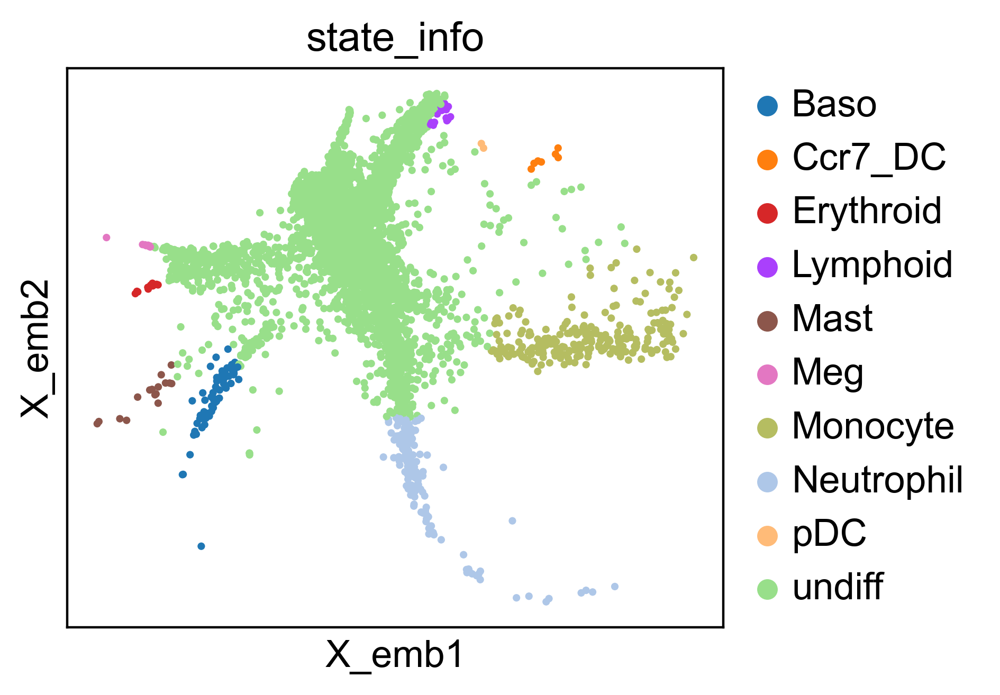

In [21]:
cs.settings.set_figure_params(dpi=200,figsize=(4,3.5))
sp_idx=np.array(adata.obs['time_info'])=='2'
print(np.sum(sp_idx))
cs.pl.embedding(adata[sp_idx],color='state_info')

14962


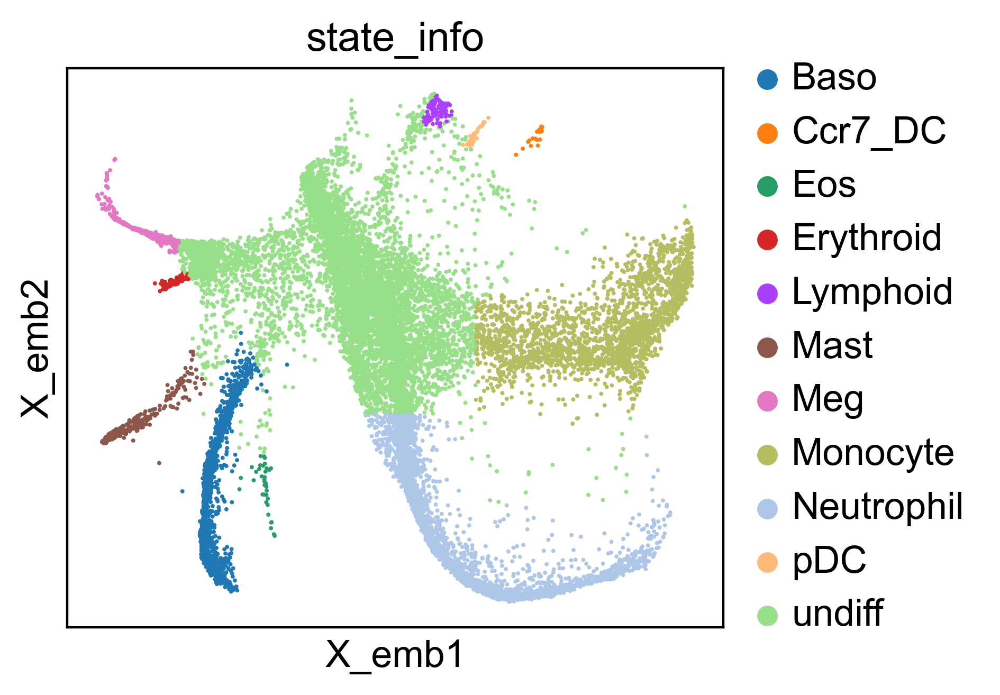

In [22]:
sp_idx=np.array(adata.obs['time_info'])=='4'
print(np.sum(sp_idx))
cs.pl.embedding(adata[sp_idx],color='state_info')

29569


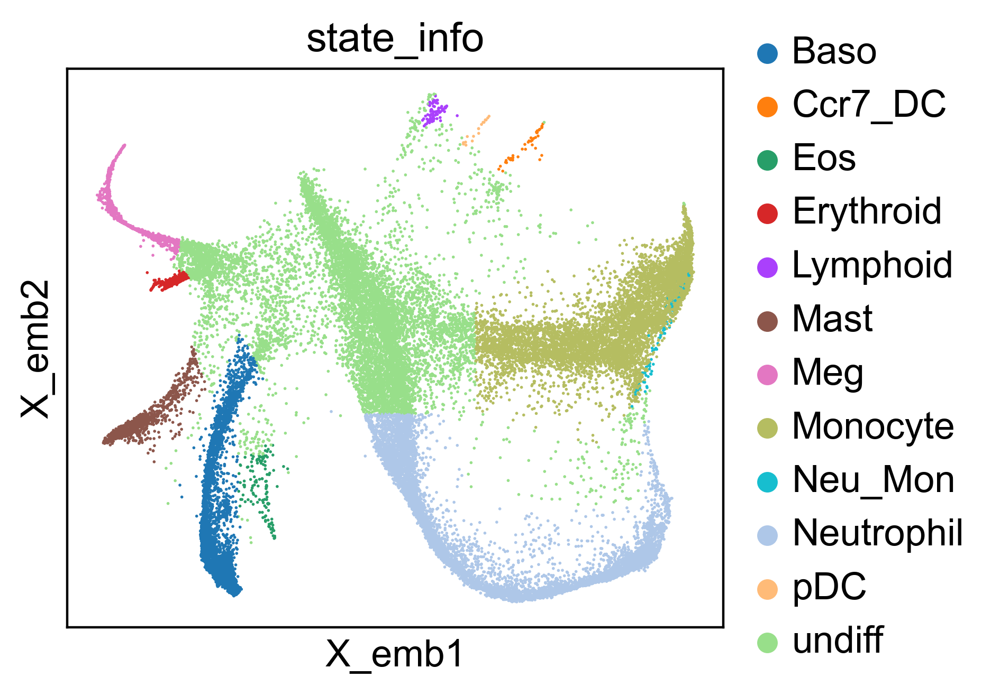

In [23]:
sp_idx=np.array(adata.obs['time_info'])=='6'
print(np.sum(sp_idx))
cs.pl.embedding(adata[sp_idx],color='state_info')

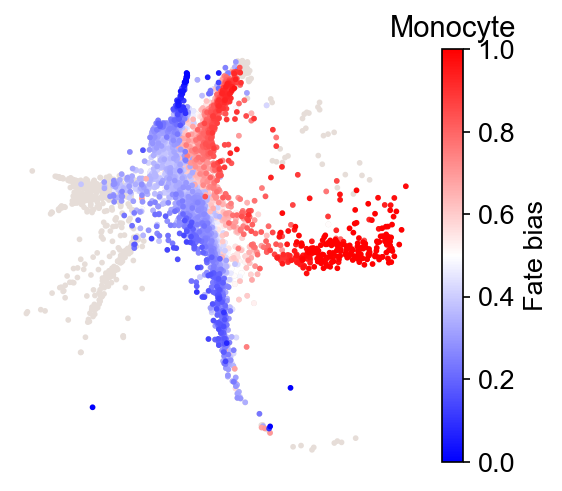

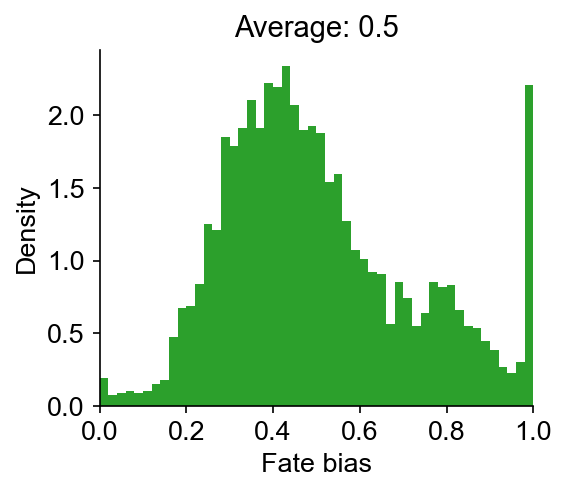

In [11]:
cs.pl.binary_fate_bias(adata,selected_fates=['Monocyte','Neutrophil'],used_Tmap='transition_map',
            selected_time_points=['2'],plot_target_state=False,
                map_backwards=True,sum_fate_prob_thresh=0.2,color_bar=True)

In [65]:
adata.uns['data_des']

['LARRY', 'LARRY_MultiTimeClone_Later_0_t*2*4*6']

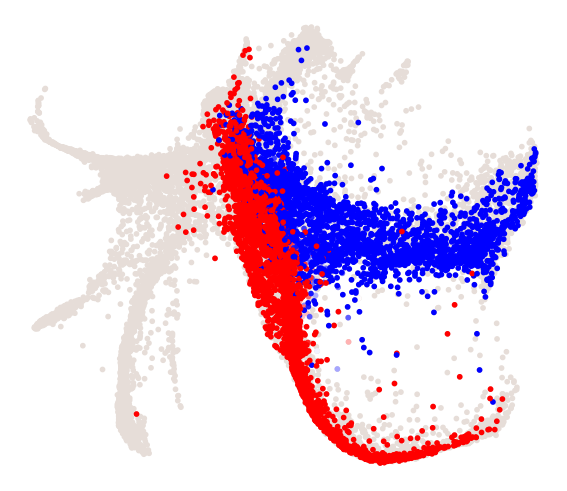

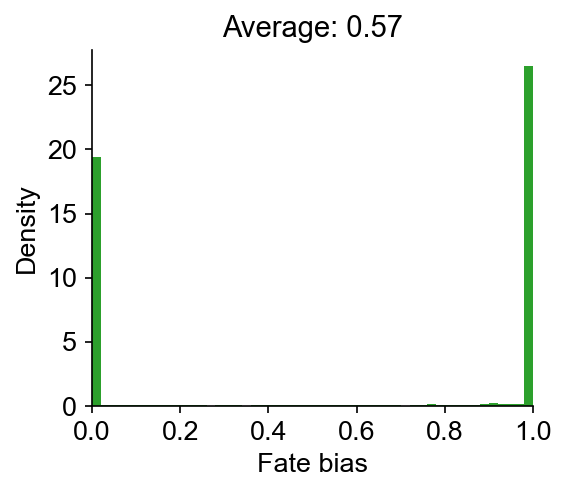

In [66]:
cs.settings.set_figure_params(format='png',figsize=[4,3.5],dpi=75,fontsize=14,pointsize=3) 

cs.pl.binary_fate_bias(adata,selected_fates=['Neutrophil','Monocyte'],used_Tmap='intraclone_transition_map',
            selected_time_points=['2','4'],plot_target_state=False,map_backwards=True,
                       sum_fate_prob_thresh=0.01,color_bar=False)

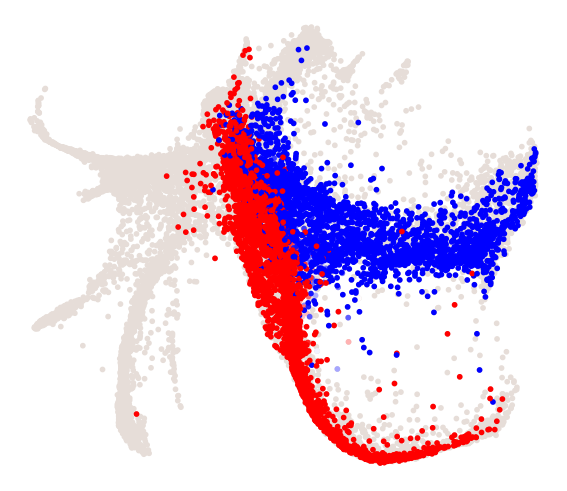

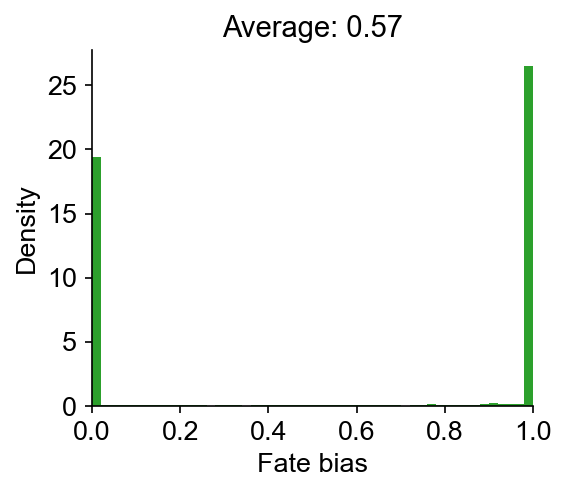

In [42]:
cs.settings.set_figure_params(format='png',figsize=[4,3.5],dpi=75,fontsize=14,pointsize=3) 

cs.pl.binary_fate_bias(adata,selected_fates=['Neutrophil','Monocyte'],used_Tmap='intraclone_transition_map',
            selected_time_points=['2','4'],plot_target_state=False,map_backwards=True,
                       sum_fate_prob_thresh=0.01,color_bar=False)

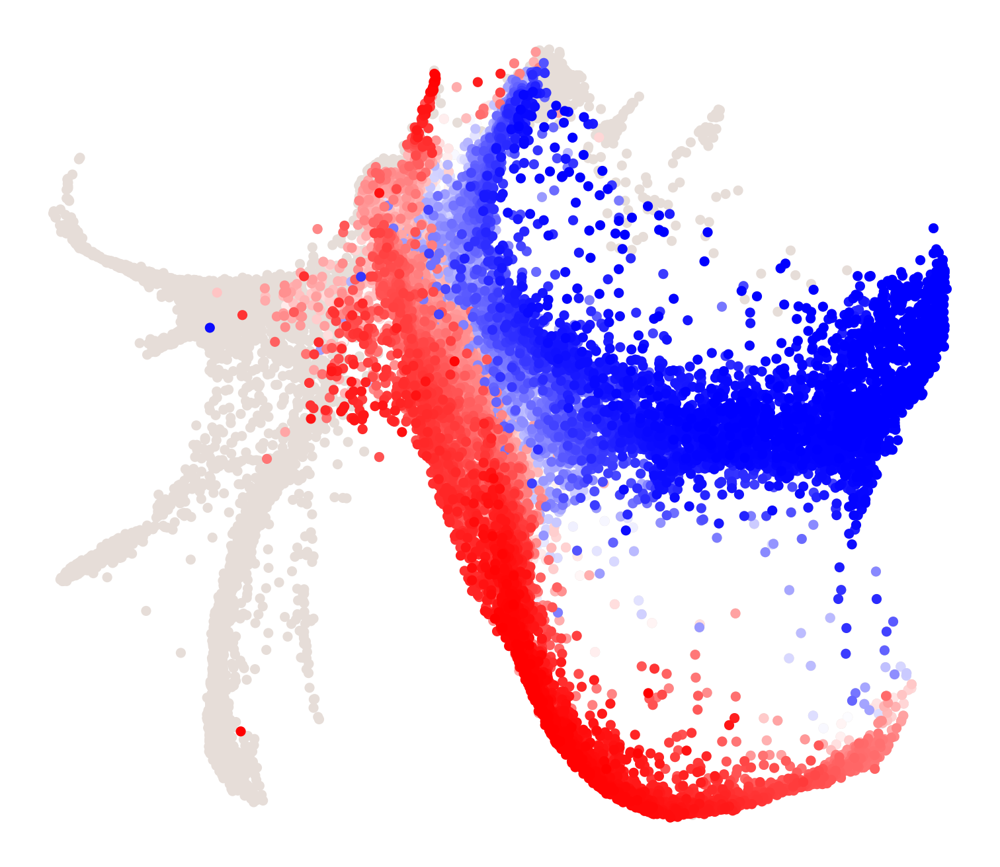

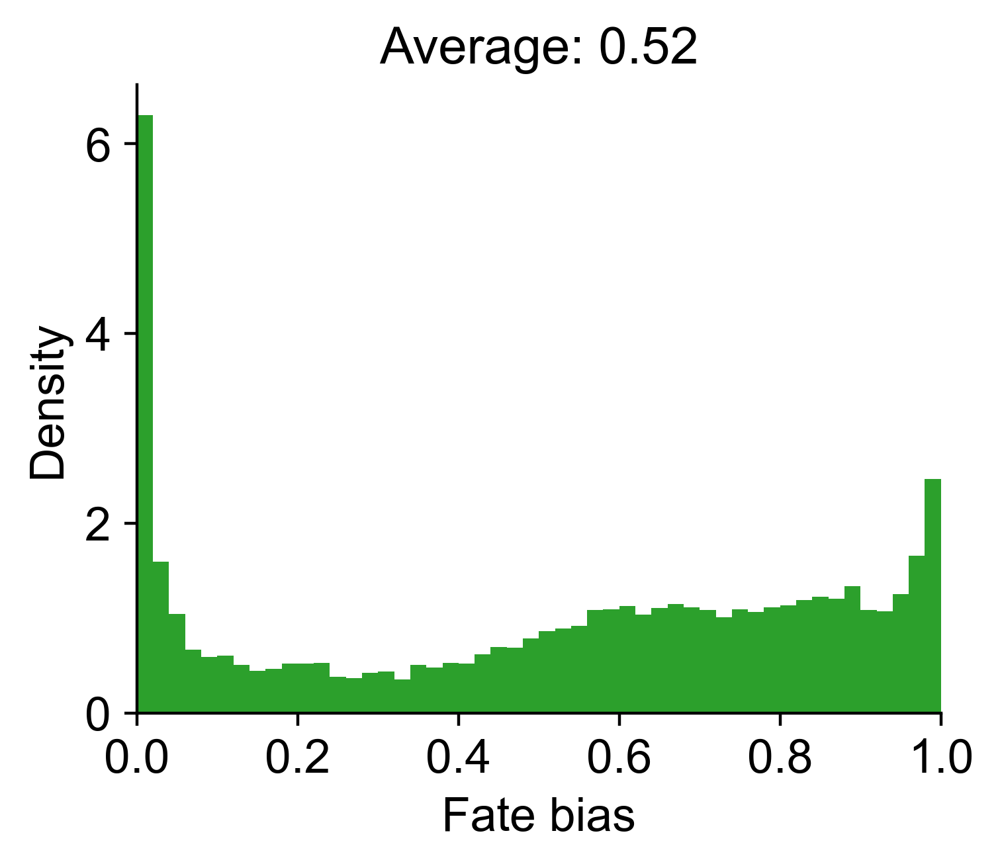

In [67]:
cs.settings.set_figure_params(format='png',figsize=[4,3.5],dpi=200,fontsize=14,pointsize=3) 

cs.pl.binary_fate_bias(adata,selected_fates=['Neutrophil','Monocyte'],used_Tmap='transition_map',
            selected_time_points=['2','4'],plot_target_state=False,map_backwards=True,
                       sum_fate_prob_thresh=0.2,color_bar=False)

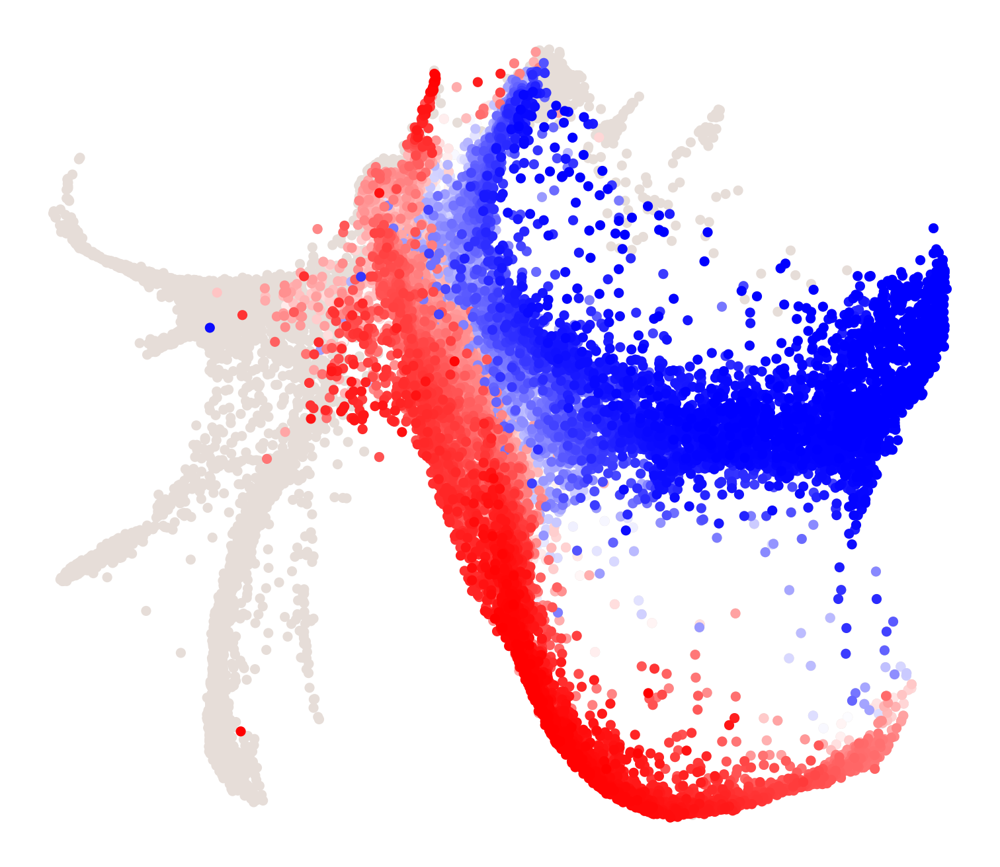

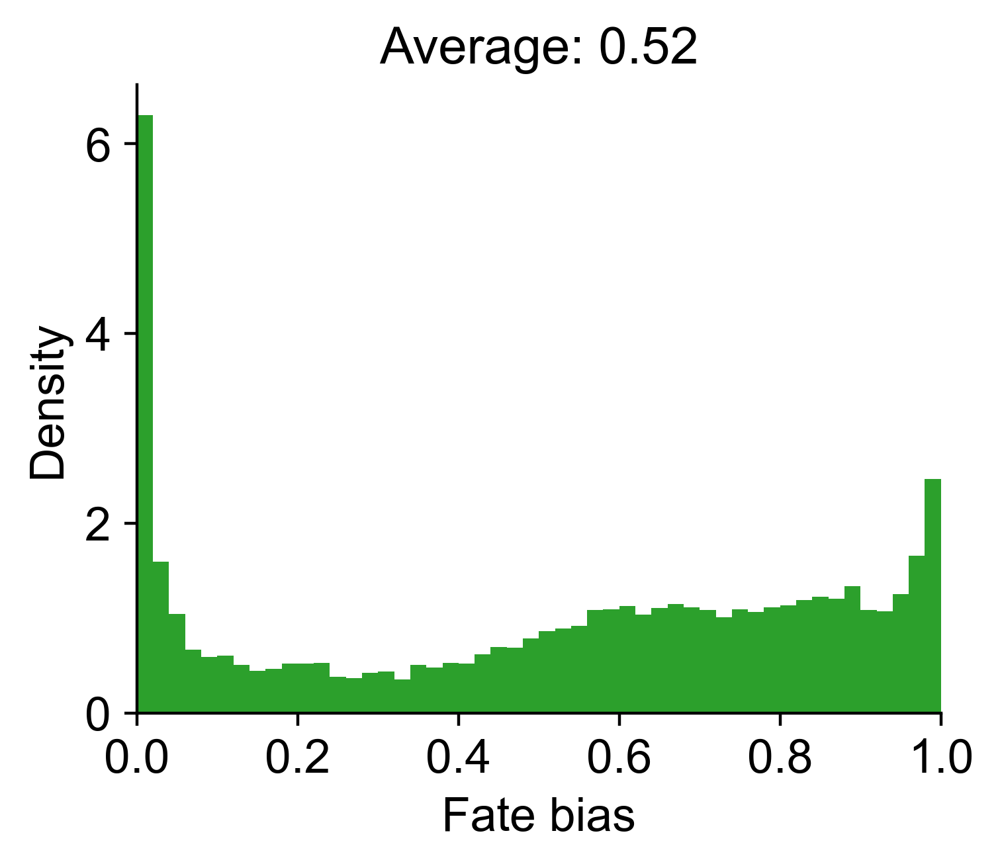

In [41]:
cs.settings.set_figure_params(format='png',figsize=[4,3.5],dpi=200,fontsize=14,pointsize=3) 

cs.pl.binary_fate_bias(adata,selected_fates=['Neutrophil','Monocyte'],used_Tmap='transition_map',
            selected_time_points=['2','4'],plot_target_state=False,map_backwards=True,
                       sum_fate_prob_thresh=0.2,color_bar=False)

#### Fate coupling of the transition map

array([[1.00000000e+00, 7.44716456e-04, 7.51267509e-04, 1.06745000e-01,
        2.06847622e-03, 2.05838507e-02, 1.26351409e-04, 6.37104703e-04,
        1.33851285e-02, 2.05284025e-01],
       [7.44716456e-04, 1.00000000e+00, 1.10862856e-01, 2.74524654e-03,
        2.07170689e-01, 3.80334956e-03, 6.60778610e-02, 2.95529826e-01,
        1.24288712e-02, 3.45960177e-03],
       [7.51267509e-04, 1.10862856e-01, 1.00000000e+00, 6.00719805e-03,
        9.54480715e-02, 9.68955981e-03, 6.24555948e-01, 9.17737244e-02,
        2.92906923e-02, 1.82148551e-02],
       [1.06745000e-01, 2.74524654e-03, 6.00719805e-03, 1.00000000e+00,
        7.86558294e-03, 7.68895288e-01, 1.12155814e-03, 3.54765328e-03,
        4.75564938e-02, 1.67811981e-01],
       [2.06847622e-03, 2.07170689e-01, 9.54480715e-02, 7.86558294e-03,
        1.00000000e+00, 9.50545466e-03, 5.34401478e-02, 7.82033678e-01,
        2.13630513e-01, 4.97704174e-02],
       [2.05838507e-02, 3.80334956e-03, 9.68955981e-03, 7.68895288e-01,
   

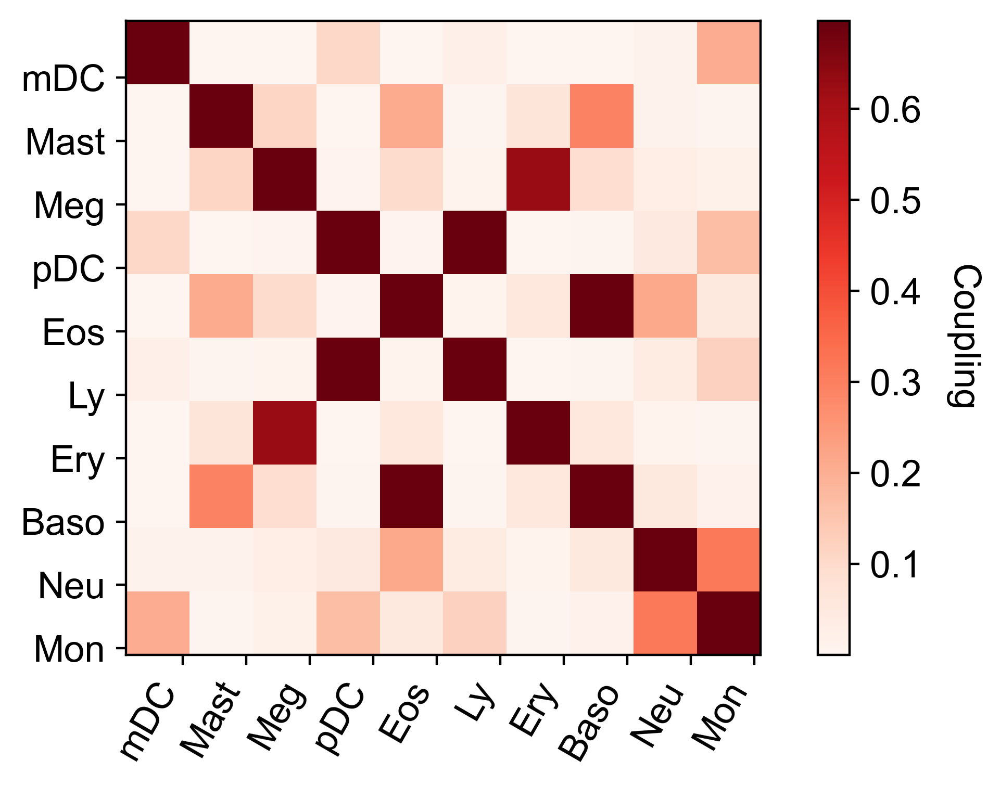

In [26]:
fate_array=['Ccr7_DC','Mast','Meg','pDC','Eos','Lymphoid','Erythroid','Baso',  'Neutrophil', 'Monocyte']
celltype_names=['mDC',  'Mast', 'Meg', 'pDC', 'Eos', 'Ly', 'Ery', 'Baso', 'Neu', 'Mon']
cs.pl.fate_coupling_from_Tmap(adata,selected_fates=fate_array,used_Tmap='transition_map',rename_selected_fates=celltype_names)


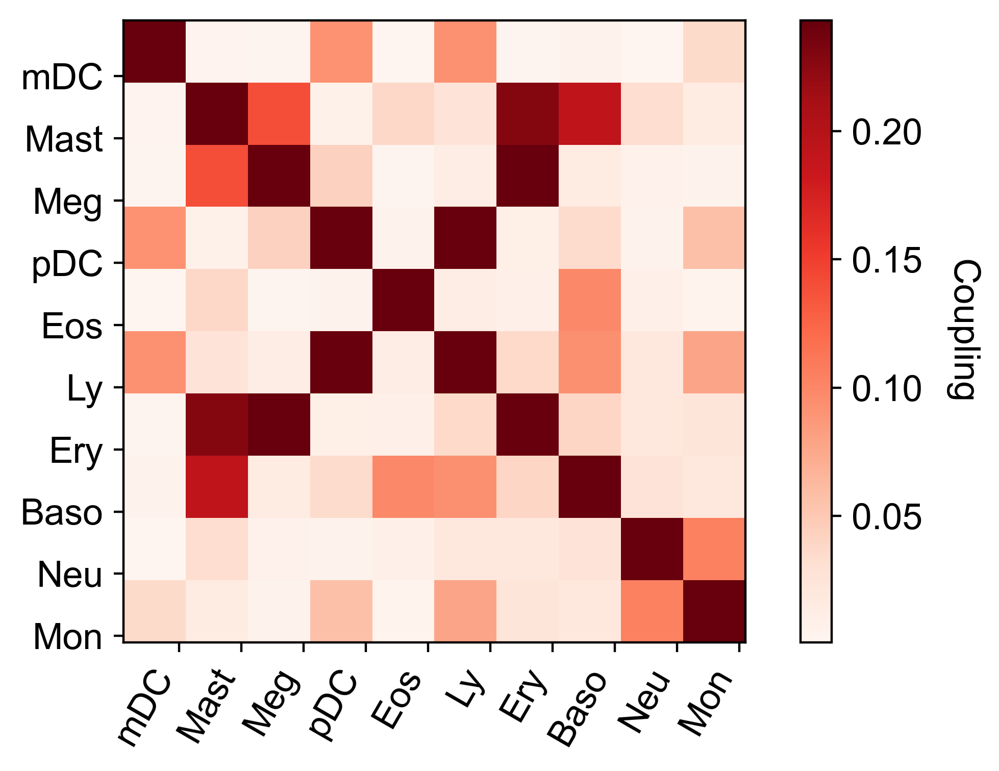

In [17]:
fate_array=['Ccr7_DC','Mast','Meg','pDC','Eos','Lymphoid','Erythroid','Baso',  'Neutrophil', 'Monocyte']
celltype_names=['mDC',  'Mast', 'Meg', 'pDC', 'Eos', 'Ly', 'Ery', 'Baso', 'Neu', 'Mon']
cs.pl.fate_coupling_from_Tmap(adata,selected_fates=fate_array,used_Tmap='transition_map',rename_selected_fates=celltype_names)


#### Dynamic trajectory inference

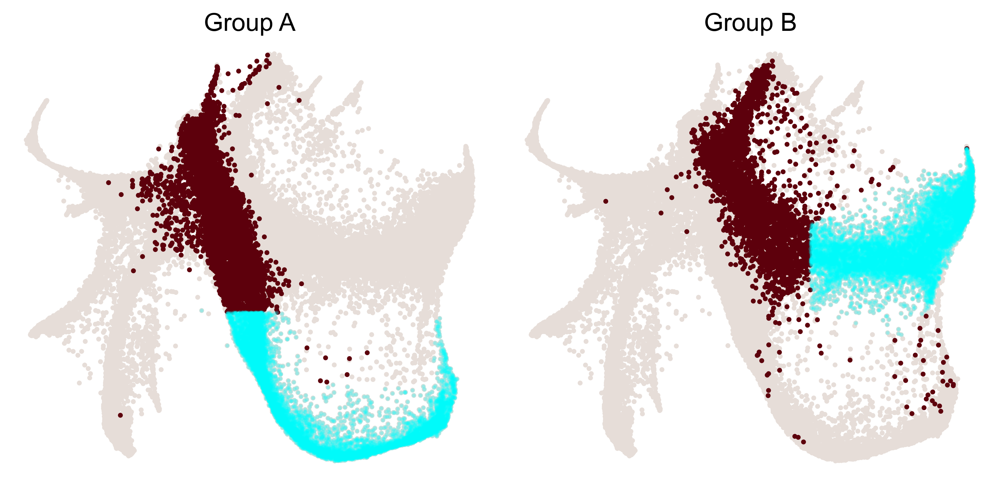

In [27]:
cs.pl.dynamic_trajectory_from_binary_fate_bias(adata, selected_fates=['Neutrophil','Monocyte'], 
 used_Tmap='transition_map', map_backwards=True, bias_threshold=0, 
                                               sum_fate_prob_thresh=0.2, avoid_target_states=True)


In [23]:
adata

AnnData object with n_obs × n_vars = 49116 × 25289
    obs: 'time_info', 'state_info', 'cell_group_A', 'cell_group_B'
    uns: 'Tmap_cell_id_t1', 'Tmap_cell_id_t2', 'available_map', 'clonal_cell_id_t1', 'clonal_cell_id_t2', 'clonal_time_points', 'data_des', 'intraclone_transition_map', 'sp_idx', 'state_info_colors', 'time_ordering', 'transition_map', 'fate_map', 'dynamic_trajectory'
    obsm: 'X_clone', 'X_emb', 'X_pca'

#### Differential genes for two ancestor groups

In [28]:
cell_group_A_0=np.array(adata.obs['cell_group_A'])
cell_group_B_0=np.array(adata.obs['cell_group_B'])

In [32]:
index_1=cs.hf.above_the_line(adata_orig.obsm['X_emb'],[0,-500],[1000,200])

mask_1=np.array(adata_orig.obs['state_info']=='undiff')

index_2=cs.hf.above_the_line(adata_orig.obsm['X_emb'],[-150,-200],[-300,500])

index_3=~cs.hf.above_the_line(adata_orig.obsm['X_emb'],[1000,500],[500,1000])

index_4=cs.hf.above_the_line(adata_orig.obsm['X_emb'],[0,-1000],[2000,-500])

index_5=cs.hf.above_the_line(adata_orig.obsm['X_emb'],[0,-300],[1000,2])

final_mask=mask_1 & index_2 & index_3 & index_4 & index_5

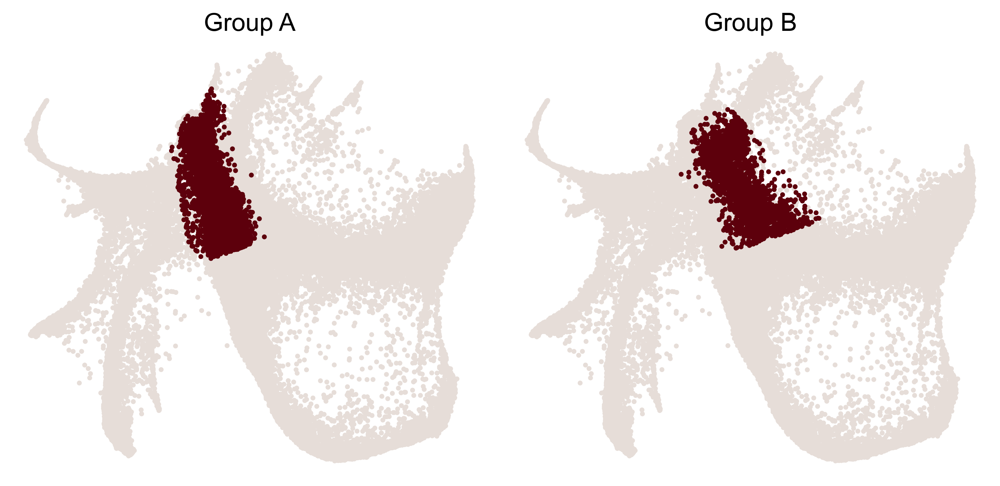

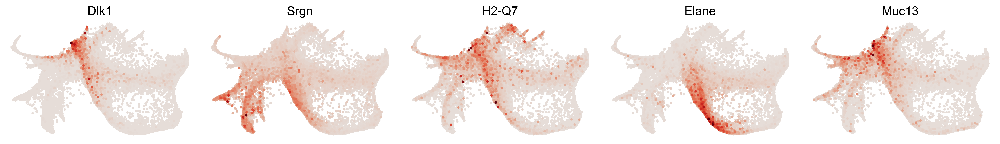

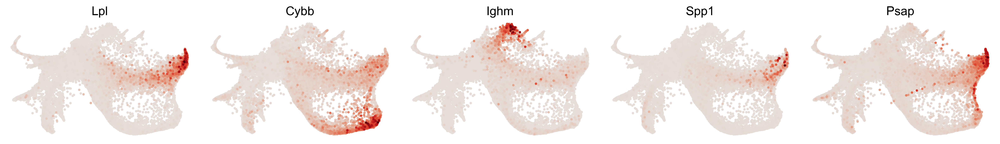

In [33]:
#np.save(f'LARRY_data/early_progenitor_mask_for_NeuMon_fate_prediction.npy',final_mask)
#final_mask=np.load(f'LARRY_data/early_progenitor_mask_diff_gene_for_NeuMon_fate_prediction.npy')
sp_idx=adata.uns['sp_idx']
cell_group_A=cell_group_A_0 & final_mask[sp_idx]
cell_group_B=cell_group_B_0 & final_mask[sp_idx]
adata.obs['cell_group_A']=cell_group_A
adata.obs['cell_group_B']=cell_group_B
dge_gene_A, dge_gene_B=cs.pl.differential_genes(adata,plot_gene_N=5)

In [34]:
dge_gene_A

,gene,pv,mean_1,mean_2,ratio
39,Dlk1,3.662528e-32,0.759019,2.223357,-0.873793
0,Srgn,5.037446e-120,11.354971,18.181709,-0.634640
1,H2-Q7,2.401588e-94,0.756932,1.713463,-0.627077
66,Elane,1.568947e-22,0.880858,1.877277,-0.613313
4,Muc13,6.132617e-74,0.770247,1.587904,-0.547834
...,...,...,...,...,...
182,Rpl28,1.920094e-10,2.972697,3.484052,-0.174684
213,H2-D1,2.536115e-09,1.385931,1.692842,-0.174577
239,Rpl17,1.370833e-08,1.392420,1.699604,-0.174277
510,Bnip3,1.526826e-03,0.660513,0.873070,-0.173776


In [40]:
adata.obs['time_info']

0        6
1        6
2        6
3        6
4        6
        ..
49111    6
49112    6
49113    6
49114    6
49115    6
Name: time_info, Length: 49116, dtype: category
Categories (3, object): ['2', '4', '6']

#### Gene trend along the dynamic trajectory

The selected states, combined with the target states are stored as dynamic trajectory at `adata.uns['dynamic_trajectory']`.
We can plot gene trend along this trajectory

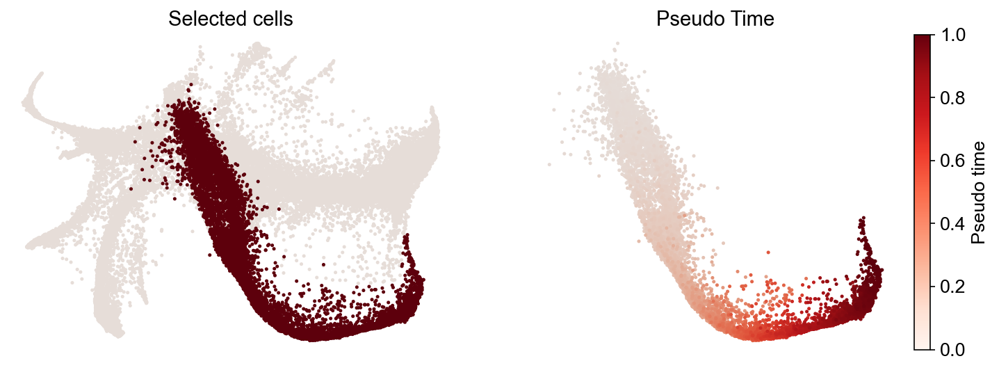

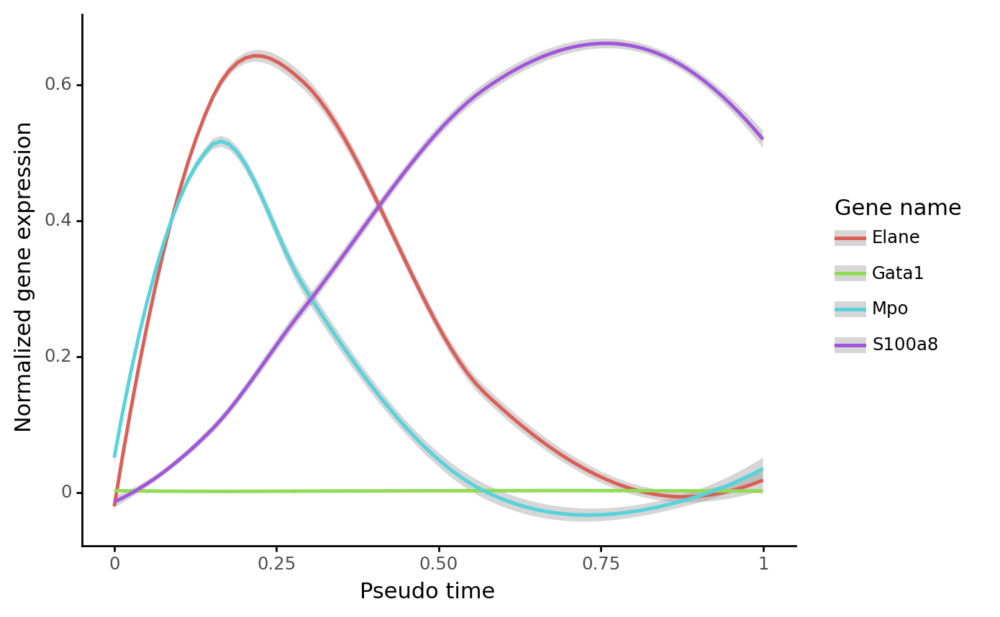

In [21]:
gene_name_list=['Gata1','Mpo', 'Elane', 'S100a8']
selected_fate='Neutrophil'
adata_selected=cs.pl.gene_expression_dynamics(adata,selected_fate,gene_name_list, traj_threshold=0.2,  
      map_backwards=True, invert_PseudoTime=False, include_target_states=True, compute_new=True, 
    gene_exp_percentile=99, n_neighbors=8, plot_raw_data=False)


In [ ]:
def infer_Tmap_from_clonal_info_alone(adata,method='naive',select_time_points=None,selected_fates=[]):
    """
    Compute transition map using only the lineage information.

    We simply average transitions across all clones, assuming that
    the intra-clone transition is uniform within the same clone. This
    function also assumes that the dataset has clones with multiple time
    points, and that it has been run through other transition map inference
    methods that define the initial and later time points of the map.

    Parameters
    ----------
    adata: :class:`~anndata.AnnData` object
    method: `str`, optional (default: 'naive')
        Method used to compute the transition map. Choice: {'naive', 
        'weinreb'}. For the naive method, we simply average transitions 
        across all clones, assuming that the intra-clone transitions are 
        uniform within the same clone. For the 'weinreb' method, we first 
        find uni-potent clones, then compute the transition map by simply 
        averaging across all clonal transitions as the naive method. 
    selected_fates: `list`, optional (default: all selected)
        List of targeted fate clusters to define uni-potent clones for the 
        weinreb method, which are used to compute the transition map. 
    select_time_points: `list`, optional (default: all)
        Select time points for computing the transition map.

    Returns
    -------
    Return a new `adata` object with the attributes adata.uns['clonal_transition_map']
    """

    hf.check_available_clonal_info(adata)
    time_info_orig=np.array(adata.uns['clonal_time_points'])
    if len(time_info_orig)<2:
        logg.error("There are no multi-time clones. Abort the inference.")

    else:
        if 'time_ordering' not in adata.uns.keys():
            hf.update_time_ordering(adata)
        time_ordering=adata.uns['time_ordering']

        if select_time_points==None:
            sel_idx_temp=np.in1d(time_ordering,time_info_orig)
            clonal_time_points=time_ordering[sel_idx_temp] # ordered clonal time points
        else:
            sel_idx_temp=np.in1d(time_ordering,select_time_points)
            clonal_time_points=time_ordering[sel_idx_temp] # ordered clonal time points            
                
        adata_1=select_time_points(adata,time_point=clonal_time_points,extend_Tmap_space=True)


        if ('Tmap_cell_id_t1' not in adata.uns.keys()) or ('Tmap_cell_id_t2' not in adata.uns.keys()) or (select_time_points is not None):
            logg.info("Update Tmap_cell_id_t1 and Tmap_cell_id_t2")
            cell_id_t2_all=adata_1.uns['Tmap_cell_id_t2']
            cell_id_t1_all=adata_1.uns['Tmap_cell_id_t1']            
        else: # use the original representation
            logg.info("Use original Tmap_cell_id_t1 and Tmap_cell_id_t2")
            cell_id_t2_all=adata.uns['Tmap_cell_id_t2']
            cell_id_t1_all=adata.uns['Tmap_cell_id_t1']

        T_map=np.zeros((len(cell_id_t1_all),len(cell_id_t2_all)))
        clone_annot=adata_1.obsm['X_clone']

        N_points=len(adata_1.uns['multiTime_cell_id_t1'])
        for k in range(N_points):

            cell_id_t1_temp=adata_1.uns['multiTime_cell_id_t1'][k]
            cell_id_t2_temp=adata_1.uns['multiTime_cell_id_t2'][k]
            if method=='naive':
                logg.info("Use all clones (naive method)")
                T_map_temp=clone_annot[cell_id_t1_temp]*clone_annot[cell_id_t2_temp].T

            else:
                logg.info("Use only uni-potent clones (weinreb method)")
                state_annote=np.array(adata_1.obs['state_info'])
                if len(selected_fates)==0:
                    selected_fates=list(set(state_annote))
                potential_vector_clone, fate_entropy_clone=hf.compute_state_potential(clone_annot[cell_id_t2_temp].T,state_annote[cell_id_t2_temp],selected_fates,fate_count=True)

                sel_unipotent_clone_id=np.array(list(set(np.nonzero(fate_entropy_clone==1)[0])))
                clone_annot_unipotent=clone_annot[:,sel_unipotent_clone_id]
                T_map_temp=clone_annot_unipotent[cell_id_t1_temp]*clone_annot_unipotent[cell_id_t2_temp].T
                logg.info(f"Used uni-potent clone fraction {len(sel_unipotent_clone_id)/clone_annot.shape[1]}")

            idx_t1=np.nonzero(np.in1d(cell_id_t1_all,cell_id_t1_temp))[0]
            idx_t2=np.nonzero(np.in1d(cell_id_t2_all,cell_id_t2_temp))[0]
            idx_t1_temp=np.nonzero(np.in1d(cell_id_t1_temp,cell_id_t1_all))[0]
            idx_t2_temp=np.nonzero(np.in1d(cell_id_t2_temp,cell_id_t2_all))[0]
            T_map[idx_t1[:,np.newaxis],idx_t2]=T_map_temp[idx_t1_temp][:,idx_t2_temp].A
            
        T_map=T_map.astype(int)
        if (select_time_points is not None): # a subsampling might happened, return adata_1 with fewer cells
            adata_1.uns['clonal_transition_map']=ssp.csr_matrix(T_map)
            return adata_1
        else:
            adata.uns['clonal_transition_map']=ssp.csr_matrix(T_map)
            adata.uns['Tmap_cell_id_t1']=cell_id_t1_all
            adata.uns['Tmap_cell_id_t2']=cell_id_t2_all
            return adata

### Transition map from only clonal information

Trying to set attribute `.uns` of view, copying.


Current time ordering from simple sorting: ['2' '4' '6']
Infer transition map between each of the initial time points ['2' '4' '6'] and the later time point 6.
-----------------Infer transition map between initial time points and the later time one-----------------------
--> Clonal cell fraction (day 2-6): 0.3677208287895311
--> Clonal cell fraction (day 6-2): 0.30305387398965133
--> Numer of cells that are clonally related -- day 2: 1686  and day 6: 8961
Valid clone number 'FOR' post selection 1216
Cell number=34154, Clone number=1216
Use only uni-potent clones (weinreb method)
Used uni-potent clone fraction 0.6282894736842105
--> Clonal cell fraction (day 4-6): 0.8093837722229649
--> Clonal cell fraction (day 6-4): 0.8744969393621699
--> Numer of cells that are clonally related -- day 4: 12110  and day 6: 25858
Valid clone number 'FOR' post selection 3047
Cell number=44531, Clone number=3047
Use only uni-potent clones (weinreb method)
Used uni-potent clone fraction 0.5612077453232688

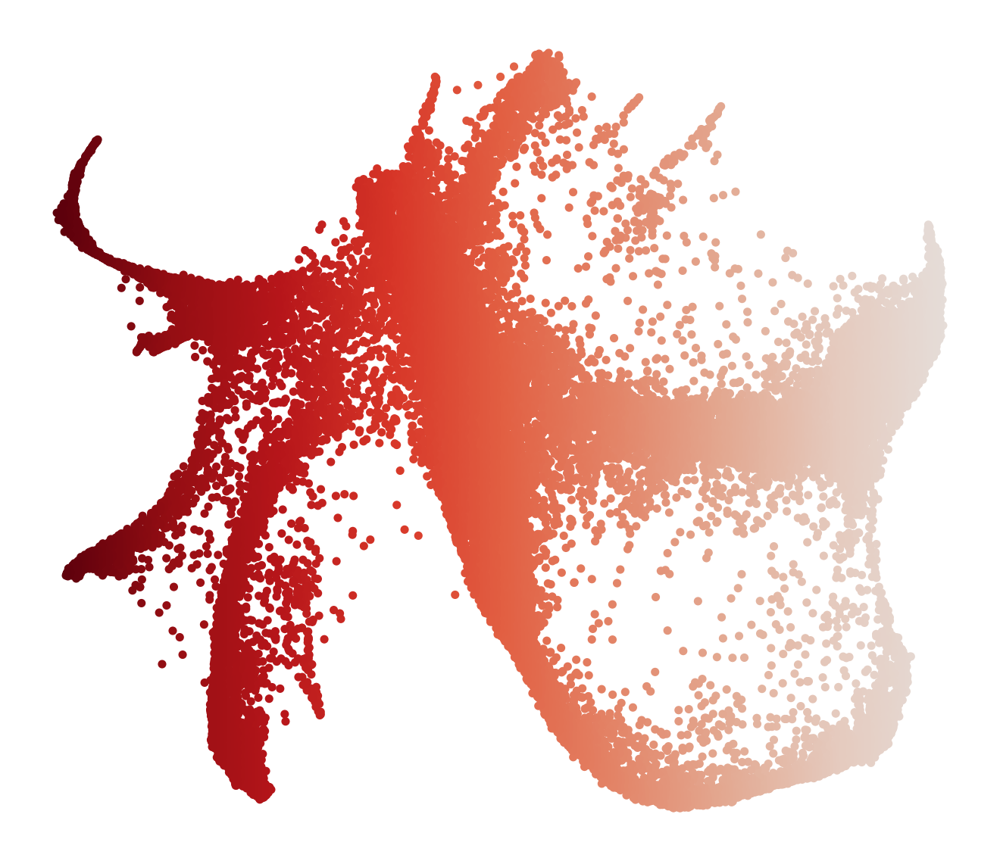

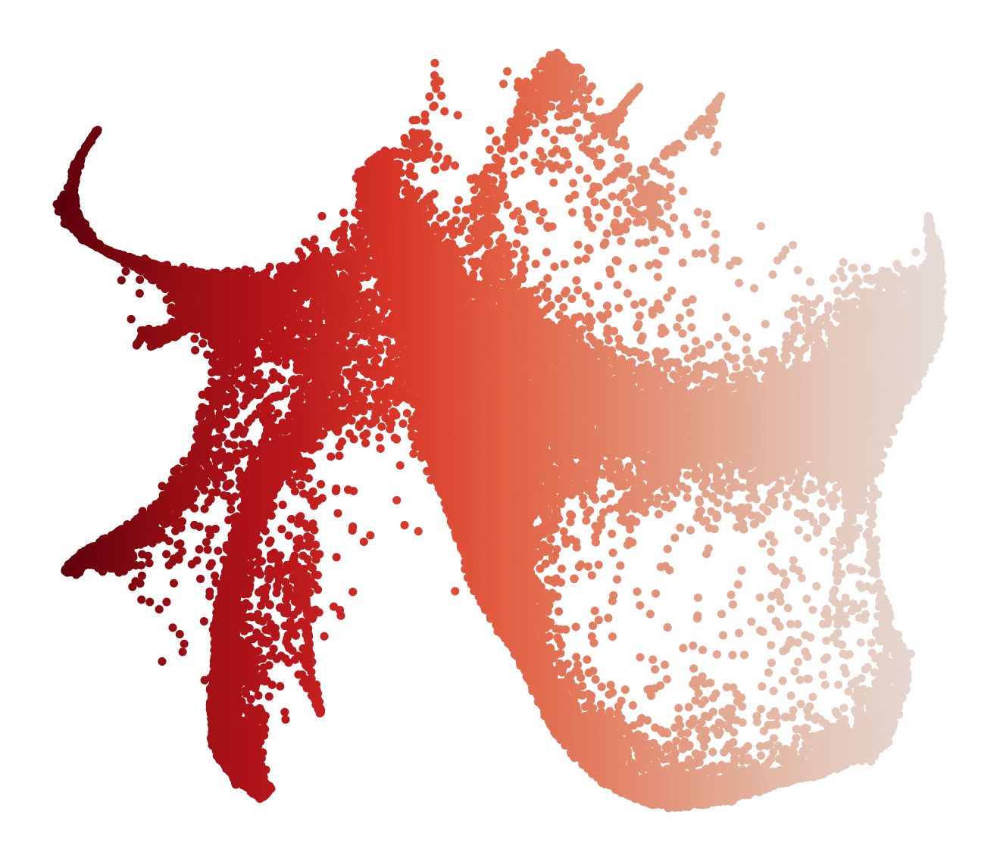

In [74]:
selected_fates=['Baso', 'Ccr7_DC', 'Eos', 'Erythroid', 'Lymphoid', 'Mast', 'Meg', 'Monocyte', 'Neu_Mon', 'Neutrophil', 'pDC']

adata1=cs.tmap.infer_Tmap_from_clonal_info_alone(adata_orig,later_time_point='6',method='weinreb',selected_fates=selected_fates)

# cs.pl.fate_map(adata_orig,selected_fates=['Neutrophil','Monocyte'],
#                used_Tmap='clonal_transition_map',map_backwards=True,plot_target_state=True)

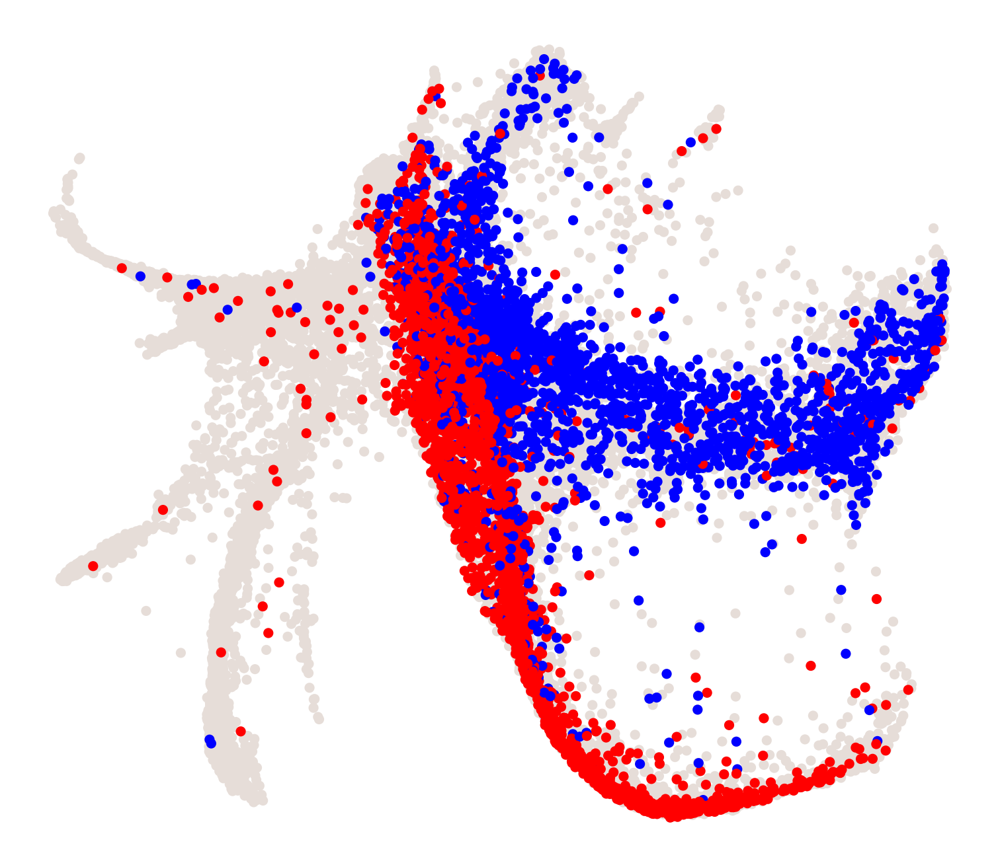

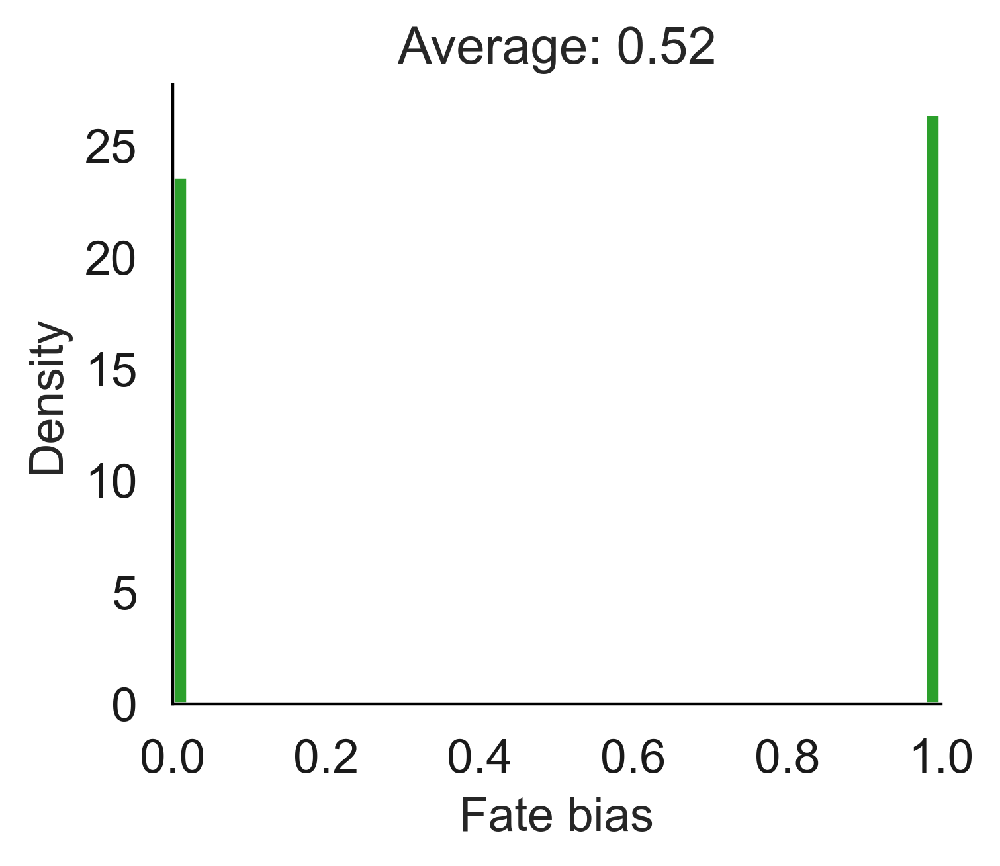

In [81]:
#cs.tmap.infer_Tmap_from_clonal_info_alone(adata,method='weinreb')

cs.pl.binary_fate_bias(adata1,selected_fates=['Neutrophil','Monocyte'],used_Tmap='clonal_transition_map',
            selected_time_points=['2','4'],plot_target_state=False,map_backwards=True,sum_fate_prob_thresh=0.1,color_bar=False)

# cs.pl.fate_map(adata,selected_fates=['Neutrophil','Monocyte'],
#                used_Tmap='clonal_transition_map',map_backwards=True,plot_target_state=True)

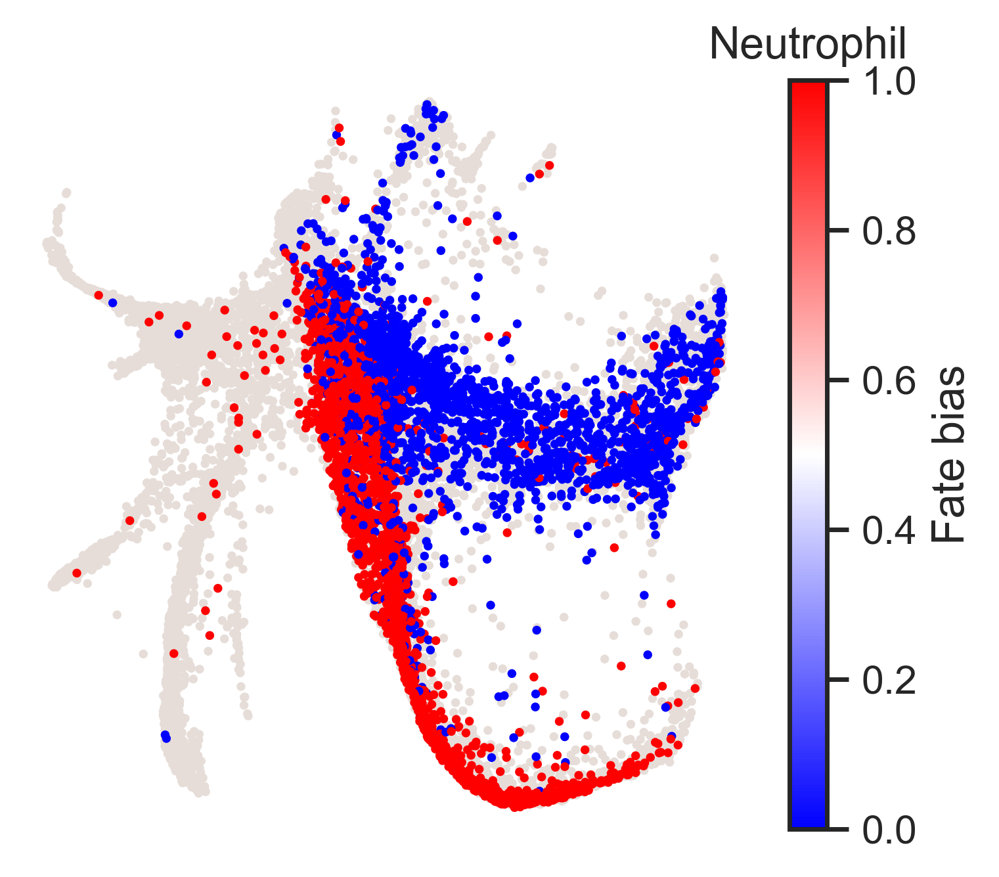

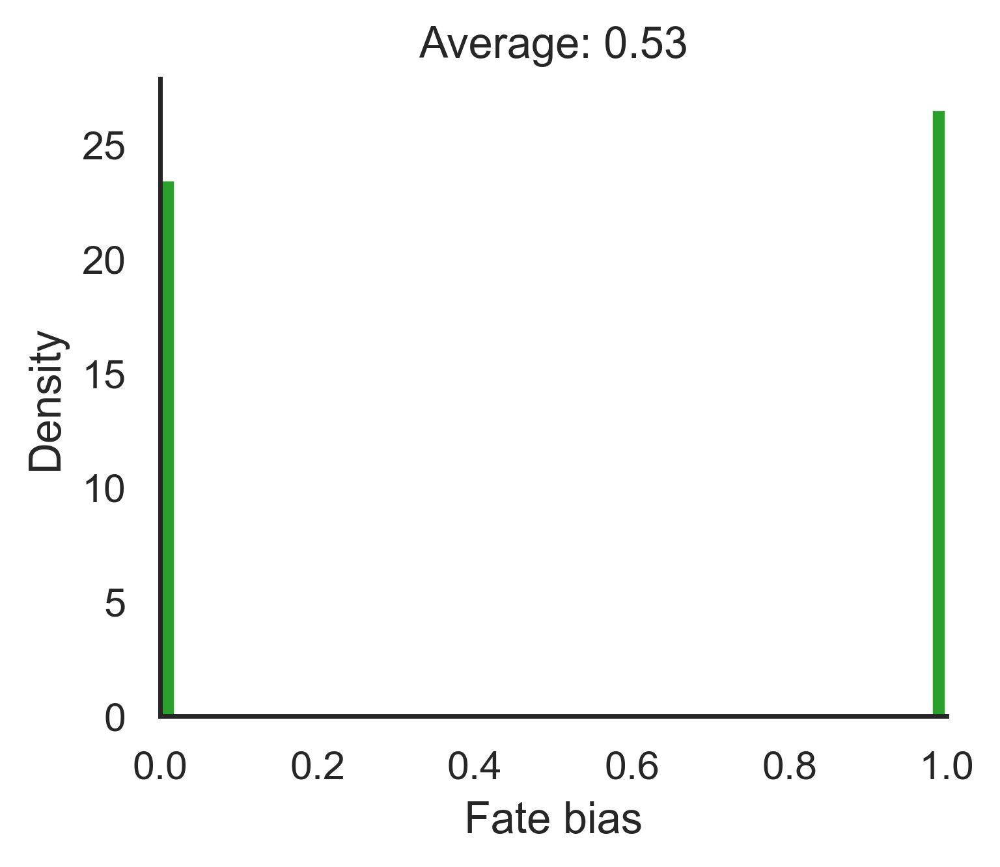

In [43]:
#cs.tmap.infer_Tmap_from_clonal_info_alone(adata,method='weinreb')

cs.pl.binary_fate_bias(adata_orig,selected_fates=['Neutrophil','Monocyte'],used_Tmap='clonal_transition_map',
            selected_time_points=['4'],plot_target_state=False,map_backwards=True,sum_fate_prob_thresh=0.1,color_bar=True)

# cs.pl.fate_map(adata,selected_fates=['Neutrophil','Monocyte'],
#                used_Tmap='clonal_transition_map',map_backwards=True,plot_target_state=True)

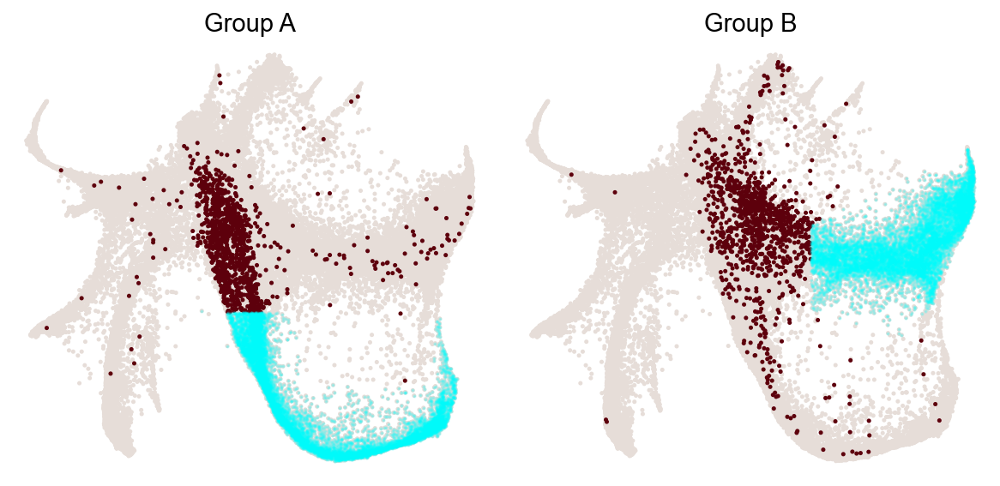

In [14]:
cs.pl.dynamic_trajectory_from_binary_fate_bias(adata_orig, selected_fates=['Neutrophil','Monocyte'], 
 used_Tmap='clonal_transition_map', map_backwards=True, bias_threshold=0, 
                selected_time_points=['4'],sum_fate_prob_thresh=0.2, avoid_target_states=True)

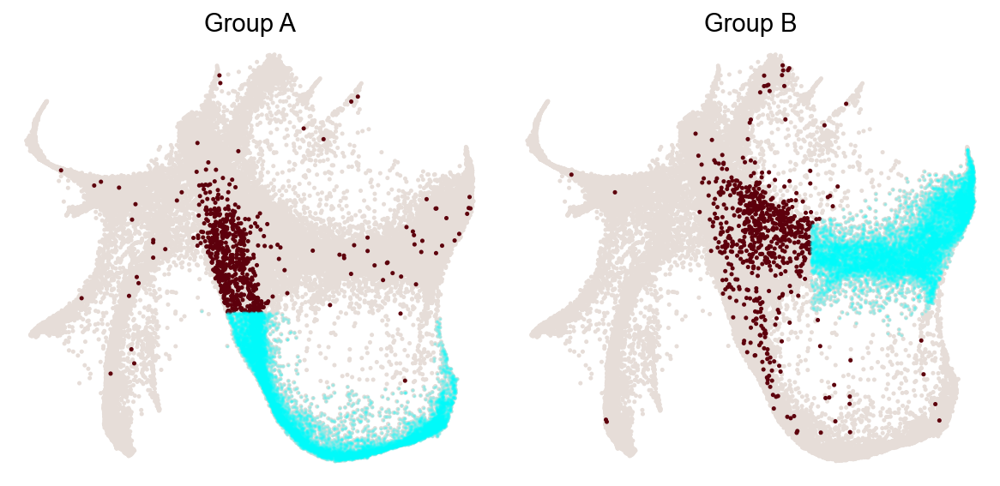

In [12]:
cs.pl.dynamic_trajectory_from_binary_fate_bias(adata_orig, selected_fates=['Neutrophil','Monocyte'], 
 used_Tmap='clonal_transition_map', map_backwards=True, bias_threshold=0, 
                selected_time_points=['4'],sum_fate_prob_thresh=0.2, avoid_target_states=True)

In [14]:
def compute_symmetric_Wasserstein_distance(prob_t0,prob_t1,full_cost_matrix,
    OT_epsilon=0.05,OT_stopThr=10**(-8),OT_max_iter=1000):
    """
    Compute symmetric Wasserstein distance between two distributions.

    Parameters
    ----------
    prob_t0: `np.array`, (n_1,)
        Distribution on initial state space.
    prob_t1: `np.array`, (n_2,)
         Distribution on later state space
    full_cost_matrix: `np.array`, shape (n_1, n_2)
        A cost matrix to map all initial states to all later states. This is a full matrix.
    OT_epsilon: `float`, optional (default: 0.05)
        Entropic regularization parameter to compute the optional 
        transport map from target to ref. 
    OT_stopThr: `float`, optional (default: 10**(-8))
        The stop thresholding for computing the transport map. 
    OT_max_iter: `float`, optional (default: 1000)
        The maximum number of iteration for computing the transport map. 

    Return 
    A vector for [forward_distance, backward_distance, the average]
    """

    import ot.bregman as otb
    # normalized distribution
    prob_t0=np.array(prob_t0)
    prob_t1=np.array(prob_t1)
    sp_id_t0=np.nonzero(prob_t0>0)[0]
    sp_id_t1=np.nonzero(prob_t1>0)[0]
    
    resol=10**(-10)
    input_t0=prob_t0[sp_id_t0]/(resol+np.sum(prob_t0[sp_id_t0]));
    input_t1=prob_t1[sp_id_t1]/(resol+np.sum(prob_t1[sp_id_t1]));

    sp_cost_matrix_t0t1=full_cost_matrix[sp_id_t0][:,sp_id_t1]
    OT_transition_map_t0t1=otb.sinkhorn_stabilized(input_t0,input_t1,sp_cost_matrix_t0t1,OT_epsilon,numItermax=OT_max_iter,stopThr=OT_stopThr)

    sp_cost_matrix_t1t0=full_cost_matrix[sp_id_t1][:,sp_id_t0]
    OT_transition_map_t1t0=otb.sinkhorn_stabilized(input_t1,input_t0,sp_cost_matrix_t1t0,OT_epsilon,numItermax=OT_max_iter,stopThr=OT_stopThr)

    Wass_dis_t0t1=np.sum(OT_transition_map_t0t1*sp_cost_matrix_t0t1)
    Wass_dis_t1t0=np.sum(OT_transition_map_t1t0*sp_cost_matrix_t1t0)
    return [Wass_dis_t0t1, Wass_dis_t1t0, (Wass_dis_t0t1+Wass_dis_t1t0)/2]

In [15]:
import pandas as pd
import numpy as np
data_path='../LARRY_inVitro_data_OldAdataData_NoCyclingGenes'
## load reference data
state_id_ref=pd.read_csv(f'{data_path}/20201126_progenitor_idx_T24_weinreb.npy')

In [16]:
state_id_ref

,Ccr7_DC,Mast,Meg,pDC,Eos,Lymphoid,Erythroid,Baso,Neutrophil,Monocyte
0,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...
49111,False,False,False,False,False,False,False,False,False,False
49112,False,False,False,False,False,False,False,False,False,False
49113,False,False,False,False,False,False,False,False,False,False
49114,False,False,False,False,False,False,False,False,False,False


In [17]:
adata.uns['sp_idx']

array([ True,  True,  True, ...,  True,  True,  True])

In [18]:
list(adata.uns.keys())

['Tmap_cell_id_t1',
 'Tmap_cell_id_t2',
 'clonal_cell_id_t1',
 'clonal_cell_id_t2',
 'data_des',
 'intraclone_transition_map',
 'proportion',
 'sp_idx',
 'transition_map',
 'clonal_time_points',
 'time_ordering',
 'clonal_transition_map',
 'available_map',
 'fate_map',
 'fate_map_output',
 'relative_fate_bias']

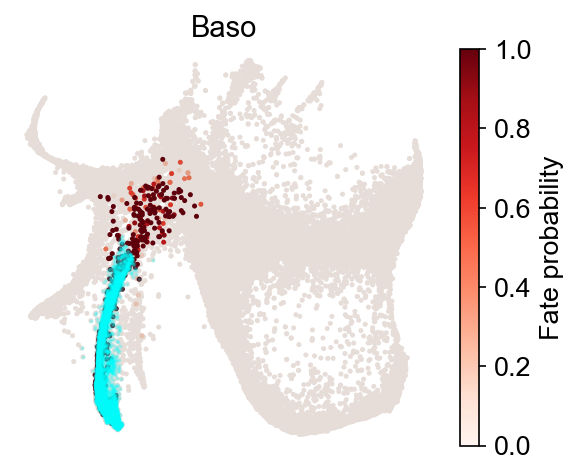

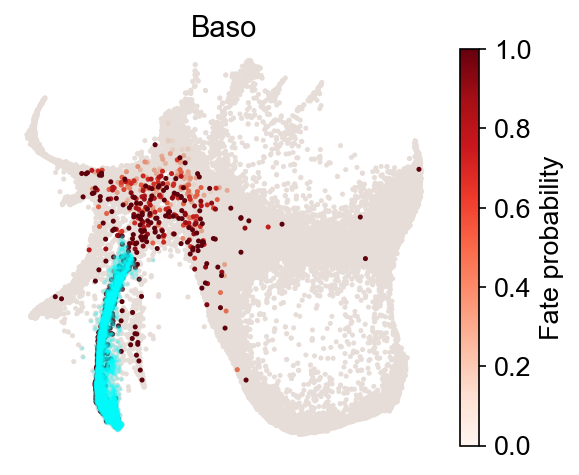

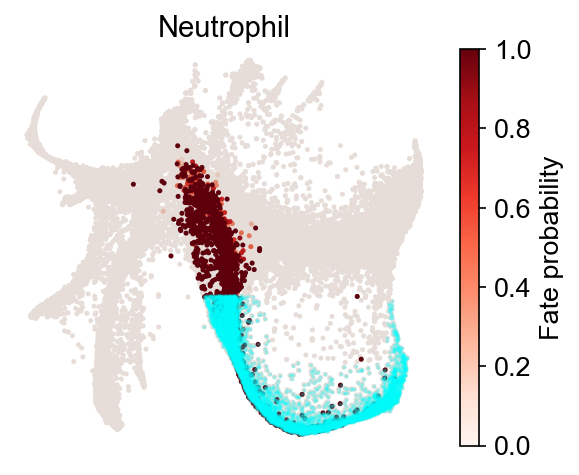

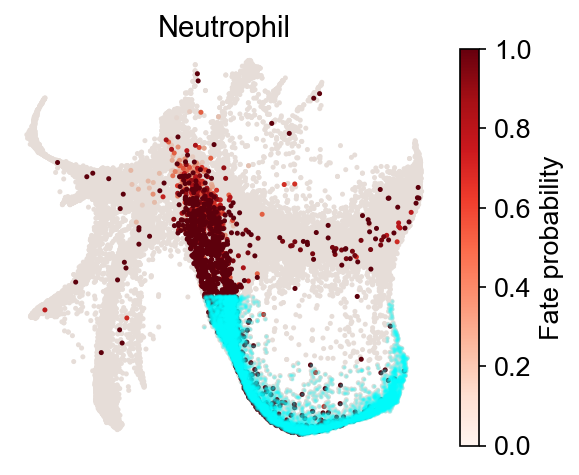

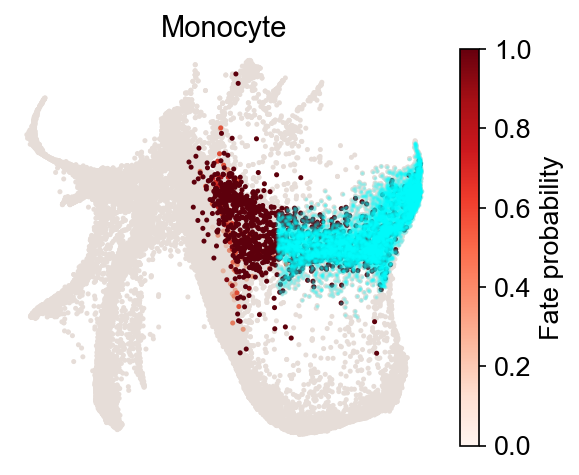

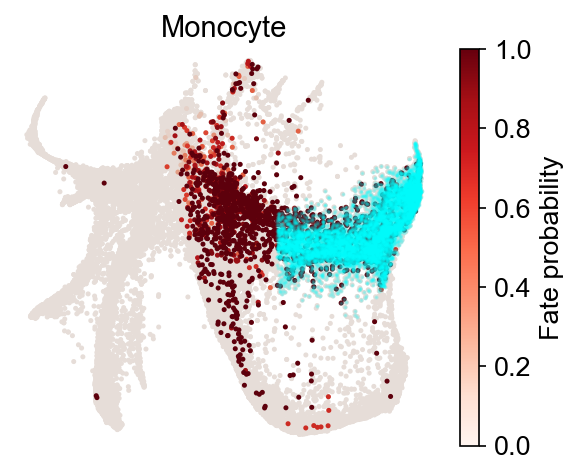

In [21]:
OT_epsilon=0.1

## load reference data
state_id_ref=pd.read_csv(f'{data_path}/20201126_progenitor_idx_T24_weinreb.npy')

full_id_target=np.nonzero(np.array(adata.uns['sp_idx']))[0] # in subspace

state_annote=np.array(adata.obs['state_info'])

map_backwards=True
plot_groups=False
#compute_new=True

#fate_array_0=['Ccr7_DC','Mast', 'Meg', 'pDC', 'Eos', 'Lymphoid', 'Erythroid', 'Baso', 'Neutrophil', 'Monocyte']
fate_array_0=['Baso','Neutrophil','Monocyte']
distance_target_ref={}

data_SPD=np.load(f'{data_path}/shortest_path_distance_Day24_KNN5.npz',allow_pickle=True)
ShortPath_dis=data_SPD['ShortPath_dis']
full_id_SPD=data_SPD['sp_id_24']

#fraction_array={};
data_des=adata.uns['data_des'][0]
file_name_CoSpar=f'{data_path}/{data_des}_progenitor_T46_SPD.npy'
for fate_id in fate_array_0:

    distance_target_ref[fate_id]=[]
    for used_Tmap in ['intraclone_transition_map','clonal_transition_map']:
        cs.pl.fate_map(adata,selected_fates=[fate_id],
            used_Tmap=used_Tmap, map_backwards=map_backwards)
        prob_group_A_sub=adata.uns['fate_map']['fate_map'].flatten()

        prob_group_A_full=np.zeros(adata.shape[0])
        cell_id_t1=adata.uns['Tmap_cell_id_t1']

        prob_group_A_full[cell_id_t1]=prob_group_A_sub
        ### remove states already exist in the selected fate cluster 
        id_temp=np.nonzero(state_annote==fate_id)[0]
        prob_group_A_full[id_temp]=0

        sub_idx_target_demulti=prob_group_A_full>0
        prob_nonZero_demulti=prob_group_A_full[sub_idx_target_demulti]


        full_id_target_demulti=full_id_target[sub_idx_target_demulti]
        sp_id_SPD_demulti=cs.hf.converting_id_from_fullSpace_to_subSpace(full_id_target_demulti,full_id_SPD)[0]

        full_id_ref=np.nonzero(np.array(state_id_ref[fate_id]))[0]
        sp_id_SPD_ref=cs.hf.converting_id_from_fullSpace_to_subSpace(full_id_ref,full_id_SPD)[0]

        mean_min_dis_demulti=np.mean(np.min(ShortPath_dis[sp_id_SPD_demulti][:,sp_id_SPD_ref],1))

        Wass_dis_demulti=compute_symmetric_Wasserstein_distance(sp_id_SPD_demulti,sp_id_SPD_ref,ShortPath_dis,target_value=prob_nonZero_demulti,OT_epsilon=OT_epsilon)

        distance_target_ref[fate_id]=distance_target_ref[fate_id]+[mean_min_dis_demulti,Wass_dis_demulti[0],Wass_dis_demulti[1],Wass_dis_demulti[2]]


In [20]:
distance_target_ref

{'Baso': [9.482612909665626,
  12.956453821337469,
  12.957352169435755,
  12.956902995386612,
  13.940479073707019,
  16.801423778030813,
  16.84040880343838,
  16.820916290734594],
 'Neutrophil': [7.0400088075050515,
  2.8689096190230415e-05,
  9.333078241544548,
  4.666553465320369,
  10.943229490742912,
  3.746798051851472e-05,
  14.055453872800234,
  7.0277456703903765],
 'Monocyte': [8.687598413555175,
  6.834759718591887e-05,
  12.882195109015958,
  6.441131728306572,
  11.971894282366673,
  4.927174981160947e-05,
  14.80127062093206,
  7.4006599463409355]}

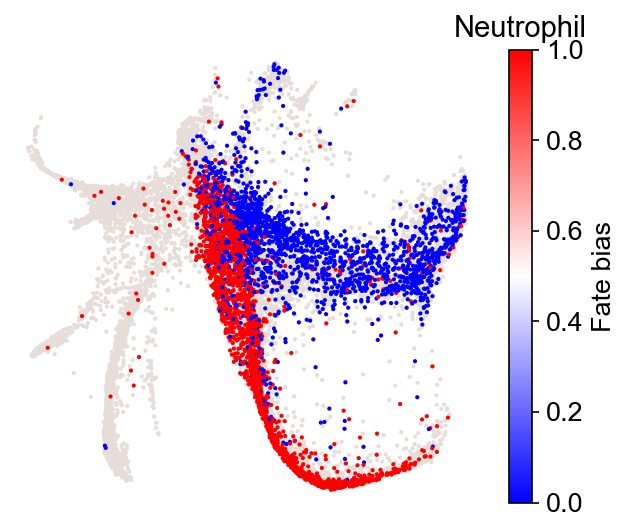

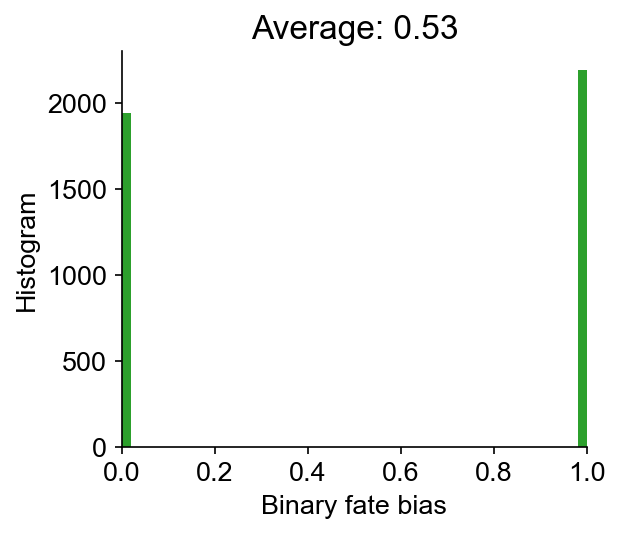

In [24]:
#cs.tmap.infer_Tmap_from_clonal_info_alone(adata,method='weinreb')

cs.pl.binary_fate_bias(adata_2,selected_fates=['Neutrophil','Monocyte'],used_Tmap='clonal_transition_map',
            selected_time_points=['4'],plot_target_state=False,map_backwards=True,sum_fate_prob_thresh=0.1,color_bar=True)

# cs.pl.fate_map(adata,selected_fates=['Neutrophil','Monocyte'],
#                used_Tmap='clonal_transition_map',map_backwards=True,plot_target_state=True)

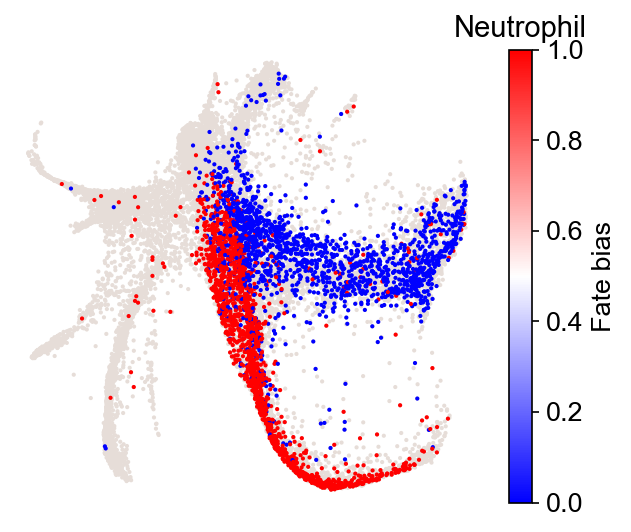

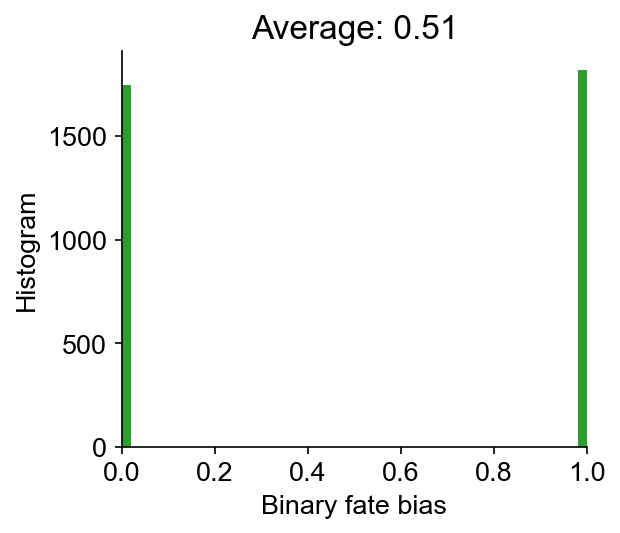

In [13]:
#cs.tmap.infer_Tmap_from_clonal_info_alone(adata,method='weinreb')

cs.pl.binary_fate_bias(adata_2,selected_fates=['Neutrophil','Monocyte'],used_Tmap='clonal_transition_map',
            selected_time_points=['2','4'],plot_target_state=False,map_backwards=True,sum_fate_prob_thresh=0.1,color_bar=True)

# cs.pl.fate_map(adata,selected_fates=['Neutrophil','Monocyte'],
#                used_Tmap='clonal_transition_map',map_backwards=True,plot_target_state=True)

In [9]:
cs.tmap.infer_Tmap_from_clonal_info_alone(adata_orig,method='weinreb')

cs.pl.binary_fate_bias(adata_orig,selected_fates=['Monocyte','Neutrophil'],used_Tmap='clonal_transition_map',
            selected_time_points=['2','4'],plot_target_state=False,map_backwards=True,sum_fate_prob_thresh=0.1,color_bar=True)

# cs.pl.fate_map(adata,selected_fates=['Neutrophil','Monocyte'],
#                used_Tmap='clonal_transition_map',map_backwards=True,plot_target_state=True)

Error: Initial time points Tmap_cell_id_t1 or later time points Tmap_cell_id_t2 not defined yet.
Please run other transition map inference methods first!
Error: used_map_name should be among []


## Part II: Infer transition map using clones from all time points

As the similarity matrices have been pre-computed, this step only takes 20 mins.

In [ ]:
noise_threshold=0.2 # 
selected_clonal_time_points=['2','4','6']
adata=cs.tmap.infer_Tmap_from_multitime_clones(adata_orig,selected_clonal_time_points,smooth_array=[20,15,10],
        noise_threshold=noise_threshold,demulti_threshold=noise_threshold,use_full_Smatrix=True)

#### Map trajectory backwards iteratively

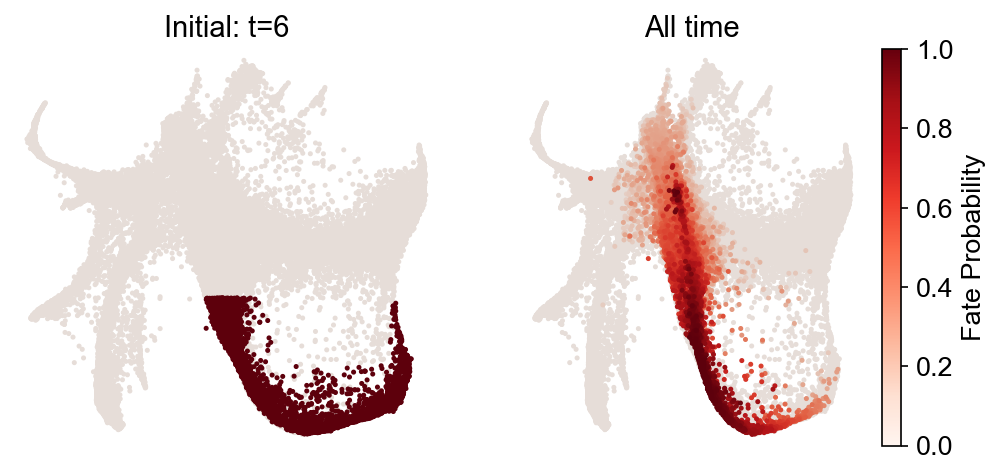

In [24]:
# combine all time points
cs.pl.dynamic_trajectory_via_iterative_mapping(adata, selected_fate='Neutrophil', used_Tmap='transition_map',
    map_backwards=True, map_threshold=0.1, plot_separately=False, apply_time_constaint=True)

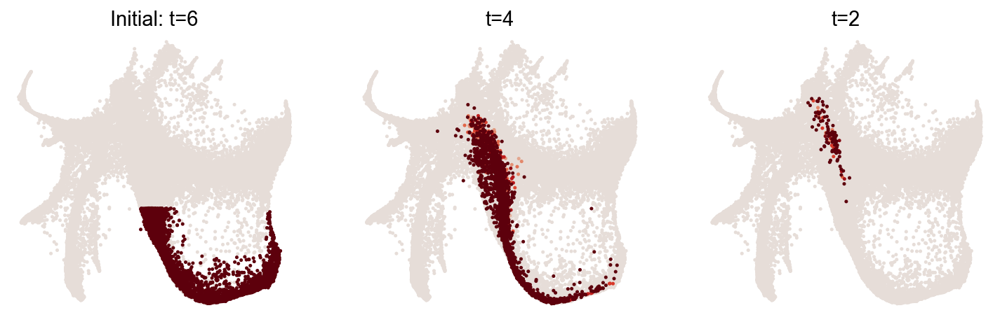

In [19]:
# plot each tiem point separately, use the intra-clone transition map. 
cs.pl.dynamic_trajectory_via_iterative_mapping(adata, selected_fate='Neutrophil', used_Tmap='intraclone_transition_map',
    map_backwards=True, map_threshold=0.1, plot_separately=True, apply_time_constaint=True,color_bar=False)

#### Gene trend along the trajectory

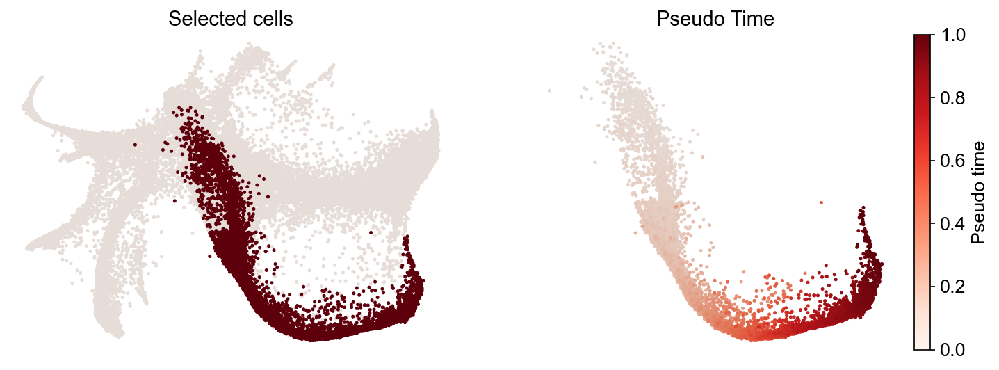

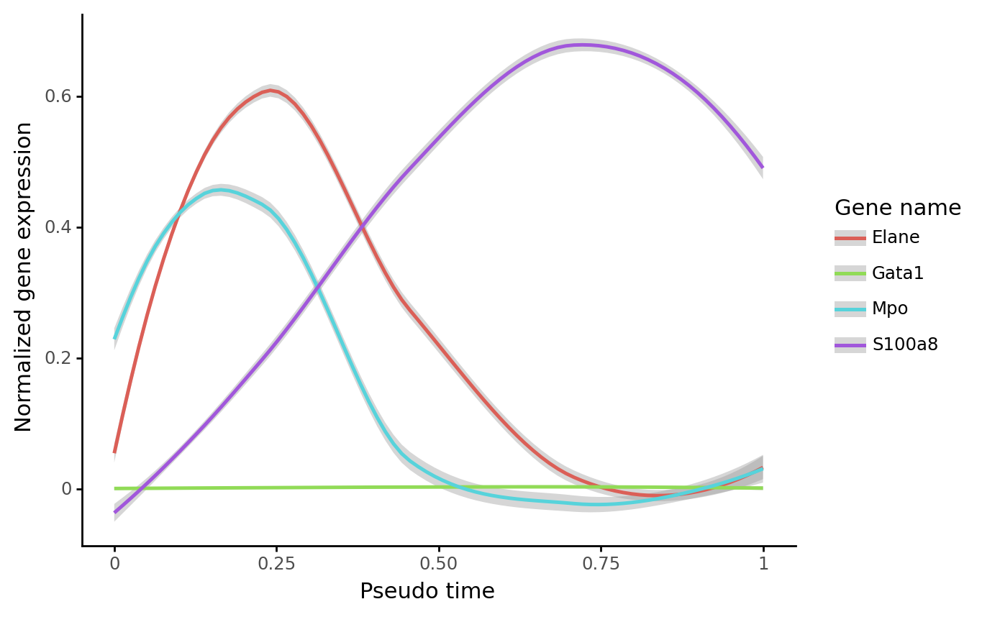

In [26]:
# The results are based on pre-computed dynamic trajectories from a previous step
# better to use the 'intraclone transition map' in the previous step. 

gene_name_list=['Gata1','Mpo', 'Elane', 'S100a8']
selected_fate='Neutrophil'
adata_selected=cs.pl.gene_expression_dynamics(adata,selected_fate,gene_name_list, traj_threshold=0.2,  
      map_backwards=True, invert_PseudoTime=False, include_target_states=True, compute_new=True, 
    gene_exp_percentile=99, n_neighbors=8, plot_raw_data=False)


## Part III: Infer transition map using only clones from the last time point

When run for the firs time, assuming that the similarity matrices are pre-computed, it takes 73 mins. Around 40 mins of which are used to compute the initialized map.

In [25]:
adata_orig_1=adata_orig.copy()
time_info=np.array(adata_orig_1.obs['time_info'])
time_info[time_info=='2']='24'
time_info[time_info=='4']='24'
adata_orig_1.obs['time_info']=time_info

In [10]:
initial_time_points=['24'] #['2','4']
clonal_time_point='6'
adata=cs.tmap.infer_Tmap_from_one_time_clones(adata_orig_1,initial_time_points,clonal_time_point,Clone_update_iter_N=1,
        initialize_method='OT',OT_cost='SPD',smooth_array=[20,15,10],
            noise_threshold=0.1,use_full_Smatrix=True,save_subset=False)

-------------------------------New Start--------------------------------------------------
Current time point: 24
-----------Pre-processing and sub-sampling cells------------
----------------
Step 1: Use OT method for initialization
Load pre-computed custon OT matrix
----------------
Step 2: Jointly optimize the transition map and the initial clonal states!
Joint optimization that consider possibility of clonal overlap: v2
--> original clone shape: (49116, 5857)
--> After excluding zero-sized clones at t2: (49116, 3949)
Sort clones by size (small to large)
Infer the number of initial cells to extract for each clone in advance
--> Inferring early clonal states: current clone id 0
--> Inferring early clonal states: current clone id 100
--> Inferring early clonal states: current clone id 200
--> Inferring early clonal states: current clone id 300
--> Inferring early clonal states: current clone id 400
--> Inferring early clonal states: current clone id 500
--> Inferring early clonal state

In [92]:
initial_time_points=['24'] #['2','4']
clonal_time_point='6'
adata=cs.tmap.infer_Tmap_from_state_info_alone(adata_orig_1,initial_time_points,clonal_time_point,Clone_update_iter_N=1,
        initialize_method='OT',OT_cost='GED',smooth_array=[20,15,10],
            noise_threshold=0.1,use_full_Smatrix=True,save_subset=False)

Generate artifical clonal data where each cell has a different barcode
-------------------------------New Start--------------------------------------------------
Current time point: 24
-----------Pre-processing and sub-sampling cells------------
----------------
Step 1: Use OT method for initialization
Load pre-computed custon OT matrix
----------------
Step 2: Jointly optimize the transition map and the initial clonal states!
Joint optimization that consider possibility of clonal overlap: v2
--> original clone shape: (49116, 49116)
--> After excluding zero-sized clones at t2: (49116, 29569)
Sort clones by size (small to large)
Infer the number of initial cells to extract for each clone in advance
--> Inferring early clonal states: current clone id 0
--> Inferring early clonal states: current clone id 100
--> Inferring early clonal states: current clone id 200
--> Inferring early clonal states: current clone id 300
--> Inferring early clonal states: current clone id 400
--> Inferring e

--> Inferring early clonal states: current clone id 13100
--> Inferring early clonal states: current clone id 13200
--> Inferring early clonal states: current clone id 13300
--> Inferring early clonal states: current clone id 13400
--> Inferring early clonal states: current clone id 13500
--> Inferring early clonal states: current clone id 13600
--> Inferring early clonal states: current clone id 13700
--> Inferring early clonal states: current clone id 13800
--> Inferring early clonal states: current clone id 13900
--> Inferring early clonal states: current clone id 14000
--> Inferring early clonal states: current clone id 14100
--> Inferring early clonal states: current clone id 14200
--> Inferring early clonal states: current clone id 14300
--> Inferring early clonal states: current clone id 14400
--> Inferring early clonal states: current clone id 14500
--> Inferring early clonal states: current clone id 14600
--> Inferring early clonal states: current clone id 14700
--> Inferring 

--> Inferring early clonal states: current clone id 27700
--> Inferring early clonal states: current clone id 27800
--> Inferring early clonal states: current clone id 27900
--> Inferring early clonal states: current clone id 28000
--> Inferring early clonal states: current clone id 28100
--> Inferring early clonal states: current clone id 28200
--> Inferring early clonal states: current clone id 28300
--> Inferring early clonal states: current clone id 28400
--> Inferring early clonal states: current clone id 28500
--> Inferring early clonal states: current clone id 28600
--> Inferring early clonal states: current clone id 28700
--> Inferring early clonal states: current clone id 28800
--> Inferring early clonal states: current clone id 28900
--> Inferring early clonal states: current clone id 29000
--> Inferring early clonal states: current clone id 29100
--> Inferring early clonal states: current clone id 29200
--> Inferring early clonal states: current clone id 29300
--> Inferring 

In [26]:
initial_time_points=['24'] #['2','4']
clonal_time_point='6'
adata=cs.tmap.infer_Tmap_from_state_info_alone(adata_orig_1,initial_time_points,clonal_time_point,Clone_update_iter_N=1,
        initialize_method='OT',OT_cost='SPD',smooth_array=[15,10,5],
            noise_threshold=0.1,use_full_Smatrix=True,save_subset=False)

Generate artifical clonal data where each cell has a different barcode
-------------------------------New Start--------------------------------------------------
Current time point: 24
-----------Pre-processing and sub-sampling cells------------
----------------
Step 1: Use OT method for initialization
Load pre-computed custon OT matrix
----------------
Step 2: Jointly optimize the transition map and the initial clonal states!
Joint optimization that consider possibility of clonal overlap: v2
--> original clone shape: (49116, 49116)
--> After excluding zero-sized clones at t2: (49116, 29569)
Sort clones by size (small to large)
Infer the number of initial cells to extract for each clone in advance
--> Inferring early clonal states: current clone id 0
--> Inferring early clonal states: current clone id 100
--> Inferring early clonal states: current clone id 200
--> Inferring early clonal states: current clone id 300
--> Inferring early clonal states: current clone id 400
--> Inferring e

--> Inferring early clonal states: current clone id 13100
--> Inferring early clonal states: current clone id 13200
--> Inferring early clonal states: current clone id 13300
--> Inferring early clonal states: current clone id 13400
--> Inferring early clonal states: current clone id 13500
--> Inferring early clonal states: current clone id 13600
--> Inferring early clonal states: current clone id 13700
--> Inferring early clonal states: current clone id 13800
--> Inferring early clonal states: current clone id 13900
--> Inferring early clonal states: current clone id 14000
--> Inferring early clonal states: current clone id 14100
--> Inferring early clonal states: current clone id 14200
--> Inferring early clonal states: current clone id 14300
--> Inferring early clonal states: current clone id 14400
--> Inferring early clonal states: current clone id 14500
--> Inferring early clonal states: current clone id 14600
--> Inferring early clonal states: current clone id 14700
--> Inferring 

--> Inferring early clonal states: current clone id 27300
--> Inferring early clonal states: current clone id 27400
--> Inferring early clonal states: current clone id 27500
--> Inferring early clonal states: current clone id 27600
--> Inferring early clonal states: current clone id 27700
--> Inferring early clonal states: current clone id 27800
--> Inferring early clonal states: current clone id 27900
--> Inferring early clonal states: current clone id 28000
--> Inferring early clonal states: current clone id 28100
--> Inferring early clonal states: current clone id 28200
--> Inferring early clonal states: current clone id 28300
--> Inferring early clonal states: current clone id 28400
--> Inferring early clonal states: current clone id 28500
--> Inferring early clonal states: current clone id 28600
--> Inferring early clonal states: current clone id 28700
--> Inferring early clonal states: current clone id 28800
--> Inferring early clonal states: current clone id 28900
--> Inferring 

In [8]:
adata_orig_1=adata_orig.copy()
time_info=np.array(adata_orig_1.obs['time_info'])
time_info[time_info=='2']='24'
time_info[time_info=='4']='24'
adata_orig_1.obs['time_info']=time_info
adata_orig_1.uns['Tmap_cell_id_t1']=np.nonzero(time_info=='24')[0]
adata_orig_1.uns['Tmap_cell_id_t2']=np.nonzero(time_info=='6')[0]

cs.tmap.compute_custom_OT_transition_map(adata_orig_1,OT_epsilon=0.05,OT_dis_KNN=5,
    OT_solver='duality_gap',OT_cost='WOT',compute_new=False)

In [29]:
adata.uns['data_des']=['LARRY', 'LARRY_StateInfo_SPD_SM15_10_5_t*24*6']

#### Plot fate map

In [15]:
adata.uns['data_des']=['LARRY', 'LARRY_StateInfo_SPD_t*4*6']

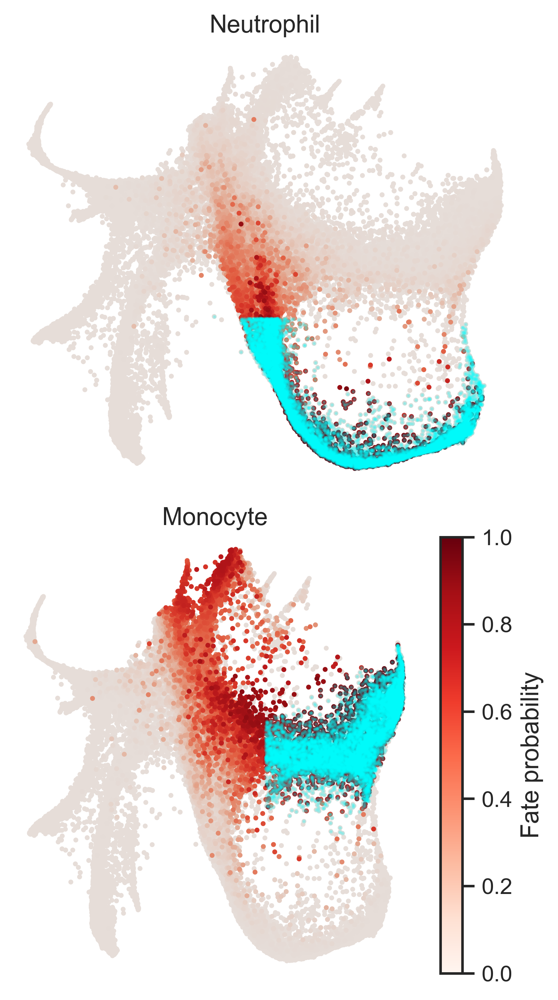

In [62]:
# SPD, [4,3,2]
cs.pl.fate_map(adata,selected_fates=['Neutrophil','Monocyte'],
               used_Tmap='transition_map',map_backwards=True,plot_target_state=True)

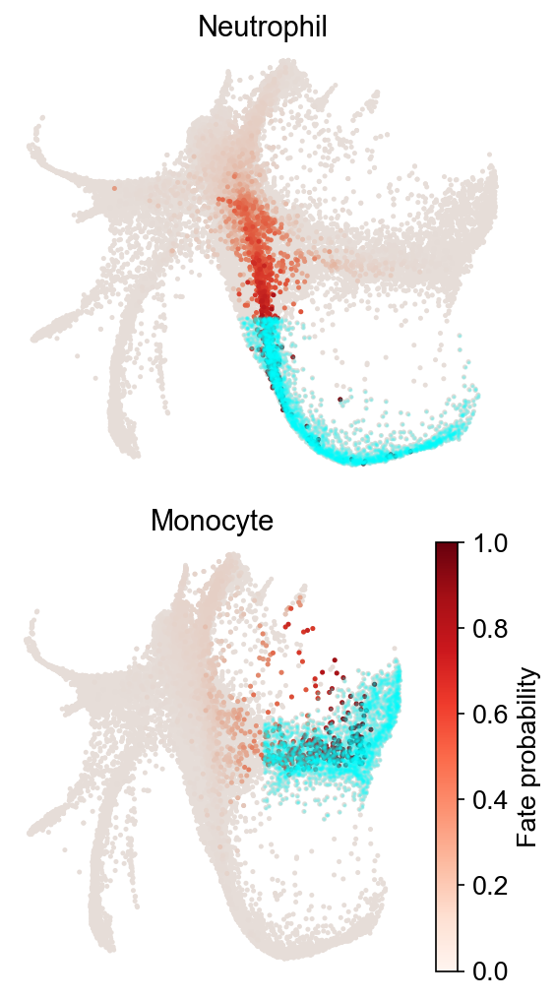

In [16]:
cs.pl.fate_map(adata,selected_fates=['Neutrophil','Monocyte'],
               used_Tmap='transition_map',map_backwards=True,plot_target_state=True)

#### Plot binary fate choice

Use the `transition_map`

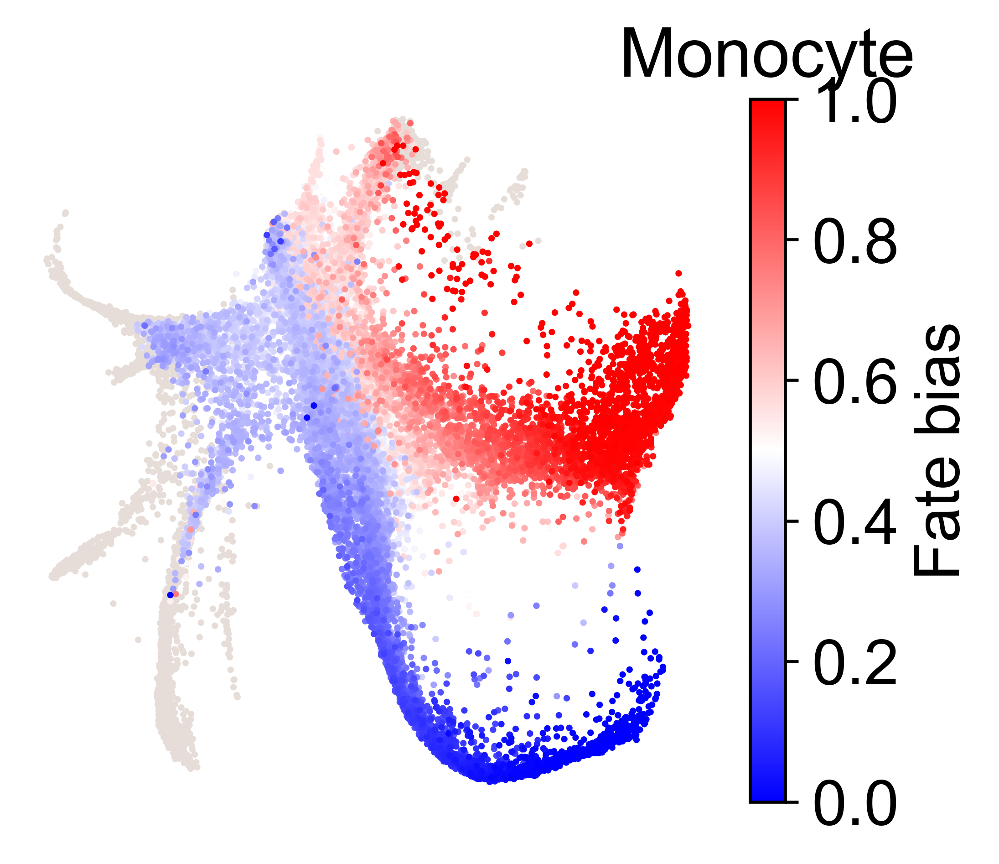

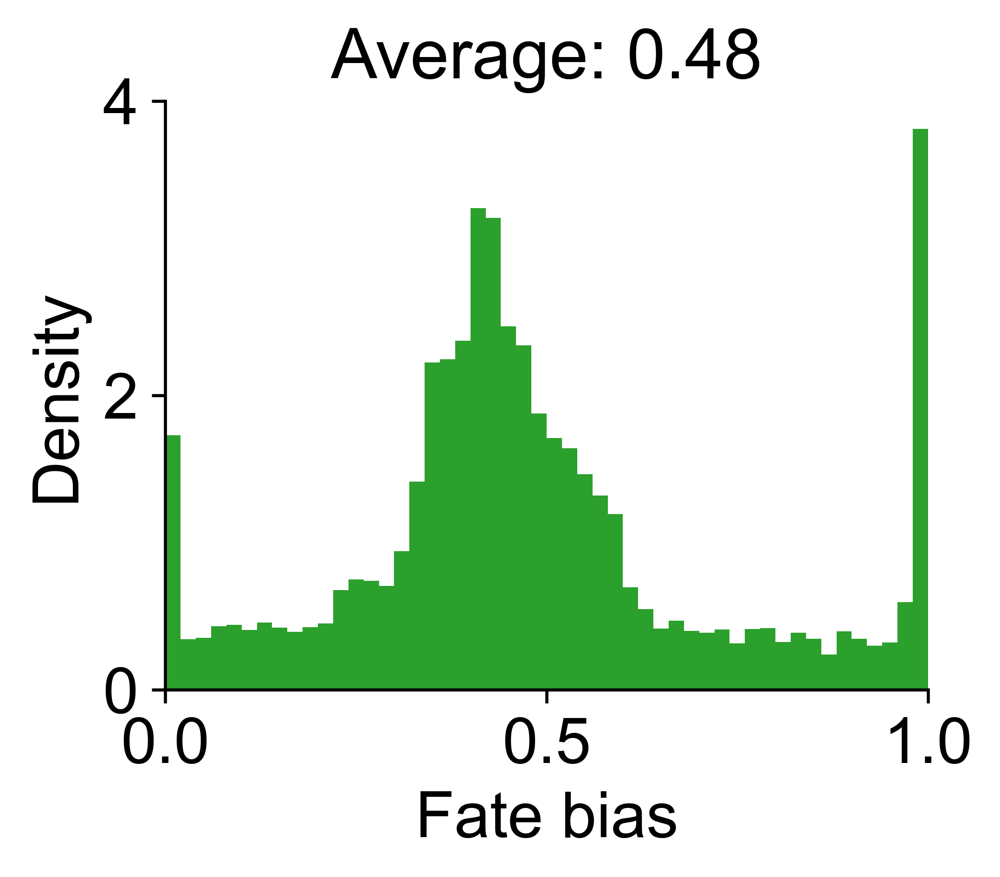

In [30]:
# [20,15,10], 0.1
cs.pl.binary_fate_bias(adata,selected_fates=['Monocyte','Neutrophil'],used_Tmap='OT_transition_map',
            plot_target_state=False,map_backwards=True,sum_fate_prob_thresh=0.1)

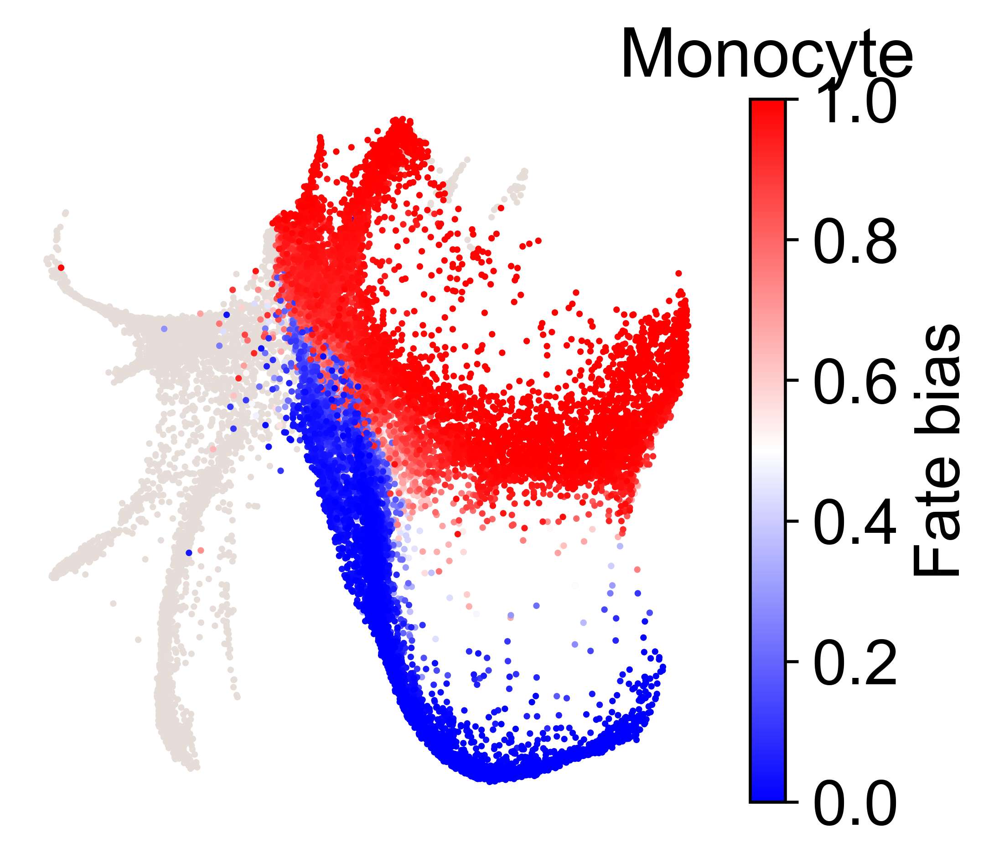

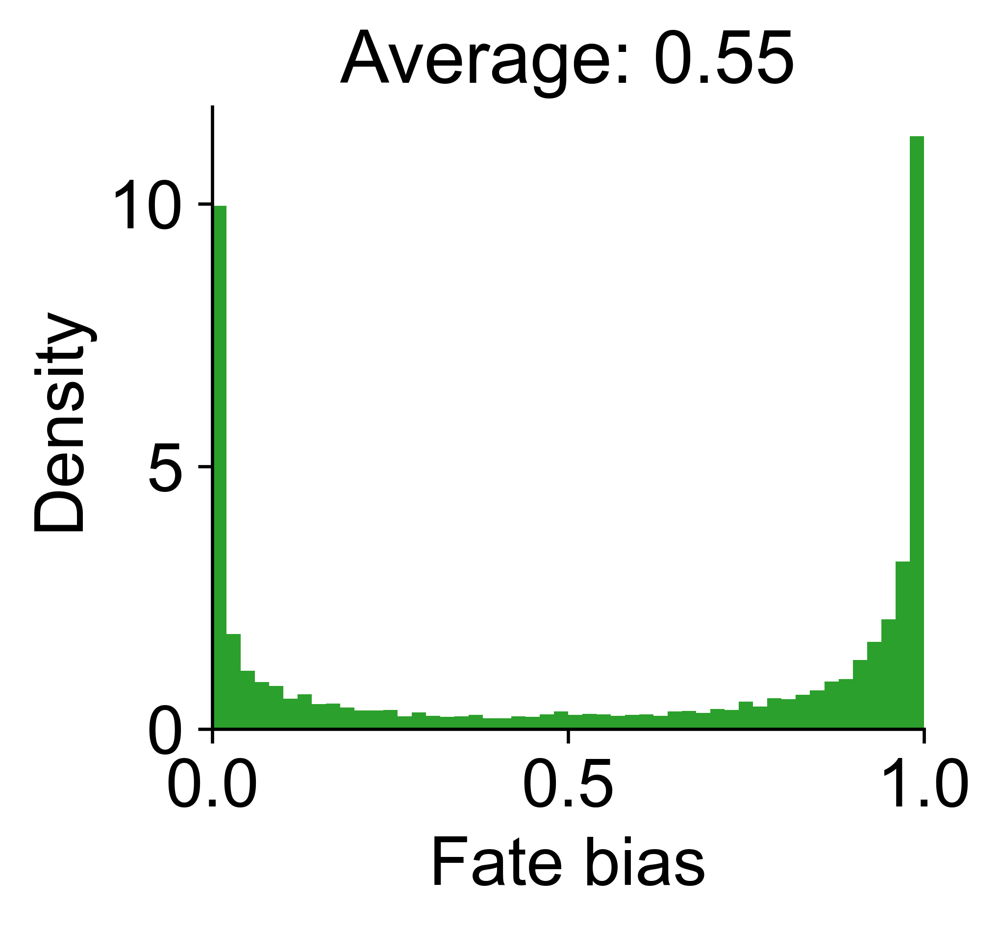

In [31]:
# [20,15,10], 0.1
cs.pl.binary_fate_bias(adata,selected_fates=['Monocyte','Neutrophil'],used_Tmap='transition_map',
            plot_target_state=False,map_backwards=True,sum_fate_prob_thresh=0.1)

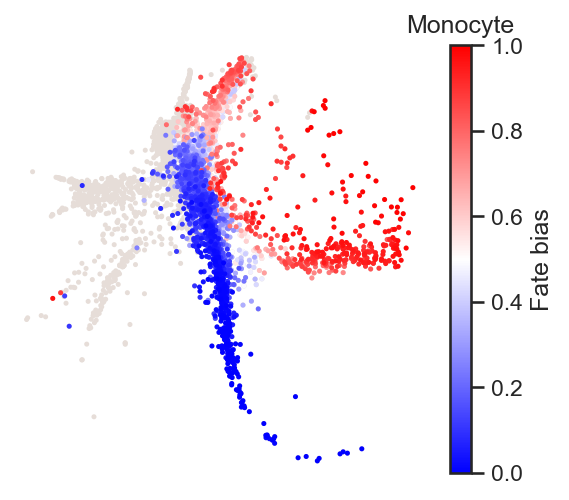

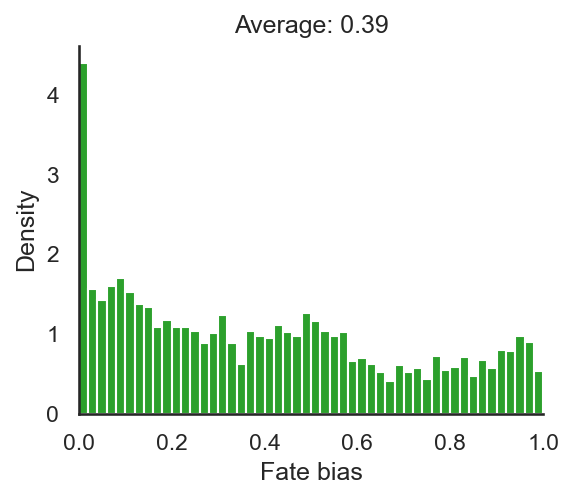

In [21]:
# SPD [5,5,5], 0.1
cs.pl.binary_fate_bias(adata,selected_fates=['Monocyte','Neutrophil'],used_Tmap='transition_map',
            selected_time_points=['2'],plot_target_state=False,map_backwards=True,sum_fate_prob_thresh=0.1)

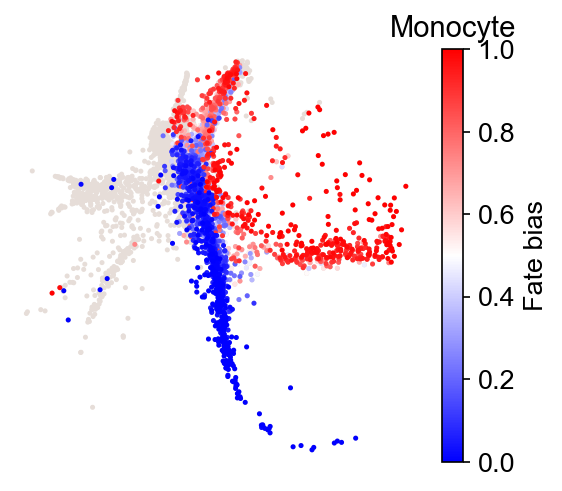

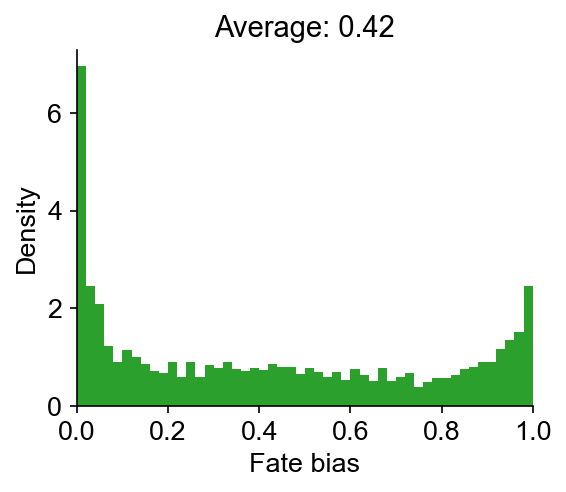

In [13]:
# SPD [4,3,2], 0.1
cs.pl.binary_fate_bias(adata,selected_fates=['Monocyte','Neutrophil'],used_Tmap='transition_map',
            selected_time_points=['2'],plot_target_state=False,map_backwards=True,sum_fate_prob_thresh=0.1)

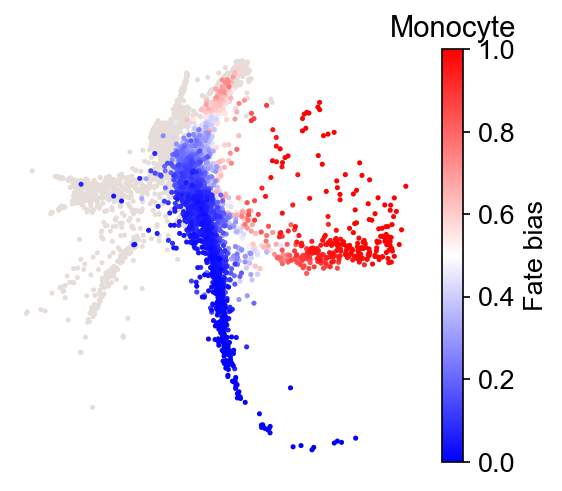

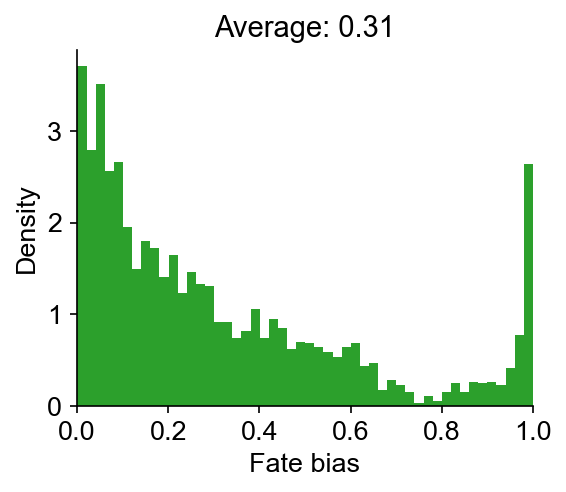

In [17]:
#n[20,15,10], 0.1
cs.pl.binary_fate_bias(adata,selected_fates=['Monocyte','Neutrophil'],used_Tmap='transition_map',
            selected_time_points=['2'],plot_target_state=False,map_backwards=True,sum_fate_prob_thresh=0.1)

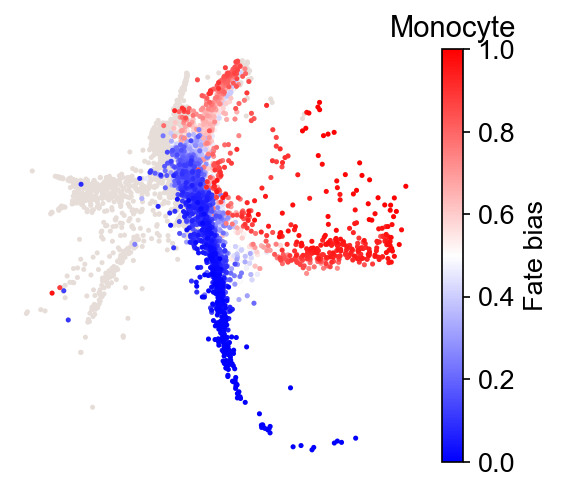

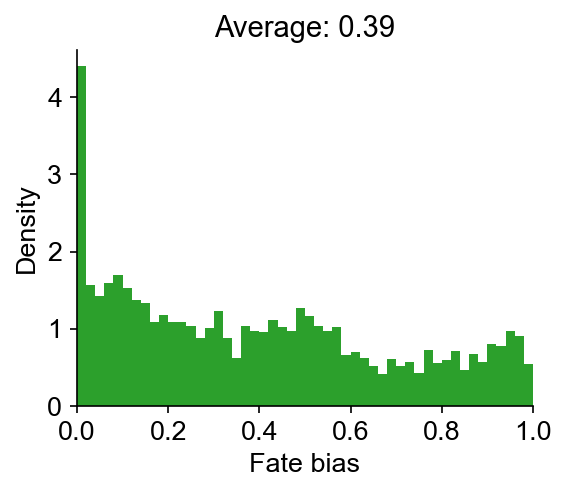

In [12]:
#n[5,5,5], 0.1
cs.pl.binary_fate_bias(adata,selected_fates=['Monocyte','Neutrophil'],used_Tmap='transition_map',
            selected_time_points=['2'],plot_target_state=False,map_backwards=True,sum_fate_prob_thresh=0.1)

Use `OT_transition_map`

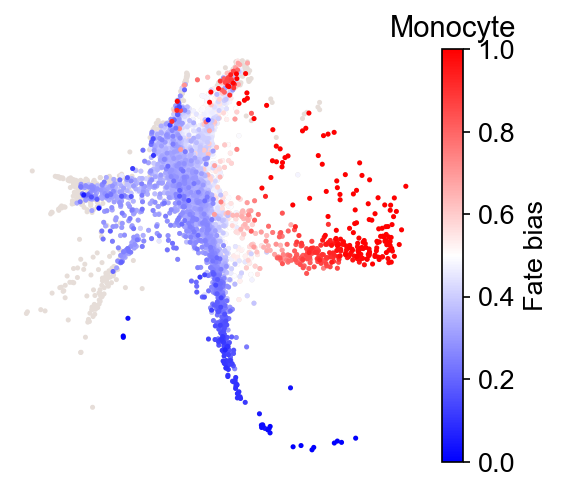

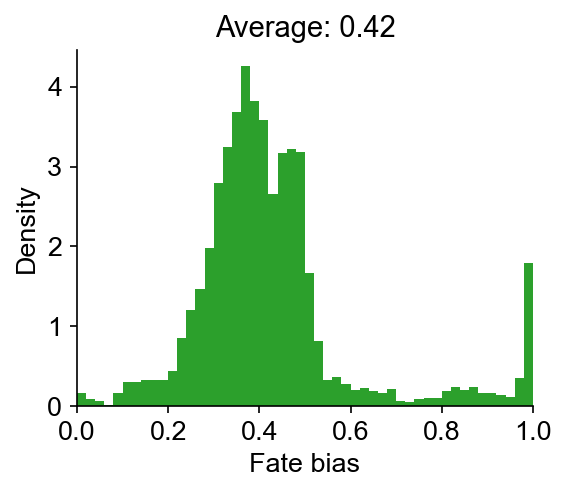

In [13]:
cs.pl.binary_fate_bias(adata,selected_fates=['Monocyte','Neutrophil'],
        used_Tmap='OT_transition_map',plot_target_state=False,map_backwards=True,sum_fate_prob_thresh=0.1)

#### Fate coupling of the transition map

Use the `transition_map`

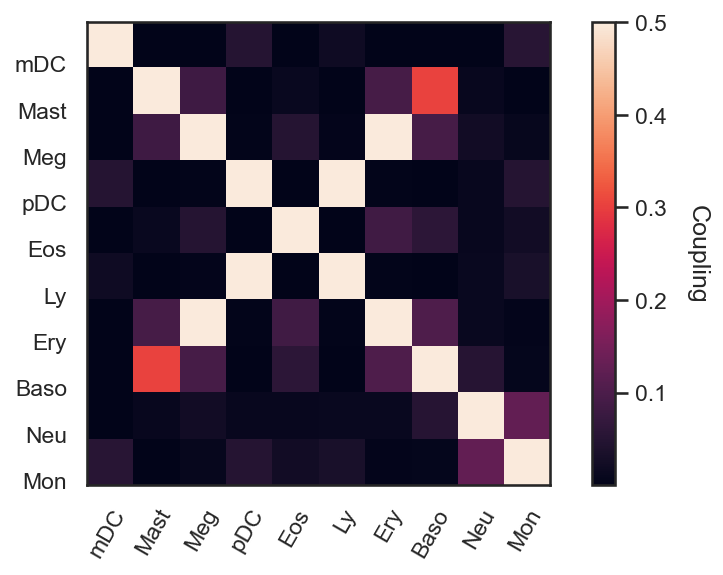

In [42]:
fate_array=['Ccr7_DC','Mast','Meg','pDC','Eos','Lymphoid','Erythroid','Baso',  'Neutrophil', 'Monocyte']
celltype_names=['mDC',  'Mast', 'Meg', 'pDC', 'Eos', 'Ly', 'Ery', 'Baso', 'Neu', 'Mon']
cs.pl.fate_coupling_from_Tmap(adata,selected_fates=fate_array,used_Tmap='transition_map',
                        rename_selected_fates=celltype_names,color_bar=True)


Use the `OT_transition_map`

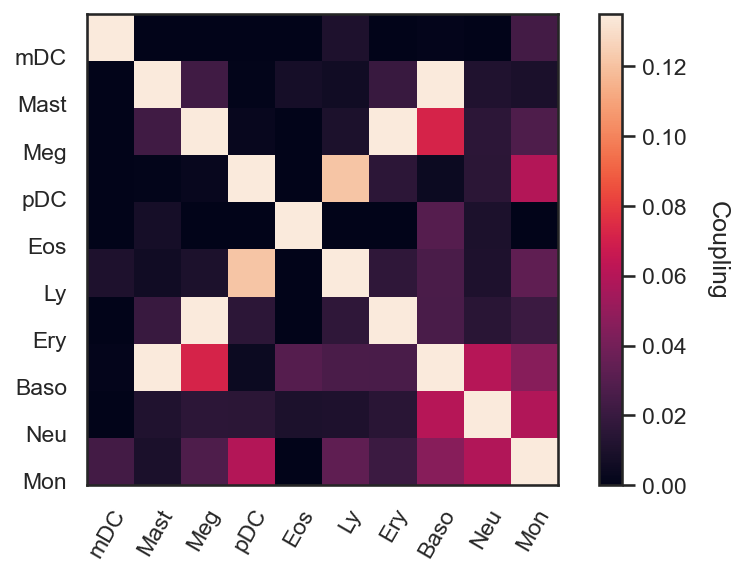

In [43]:
fate_array=['Ccr7_DC','Mast','Meg','pDC','Eos','Lymphoid','Erythroid','Baso',  'Neutrophil', 'Monocyte']
celltype_names=['mDC',  'Mast', 'Meg', 'pDC', 'Eos', 'Ly', 'Ery', 'Baso', 'Neu', 'Mon']
cs.pl.fate_coupling_from_Tmap(adata,selected_fates=fate_array,used_Tmap='OT_transition_map',
                        rename_selected_fates=celltype_names,color_bar=True)


#### Dynamic trajectory inference

From `transition_map`

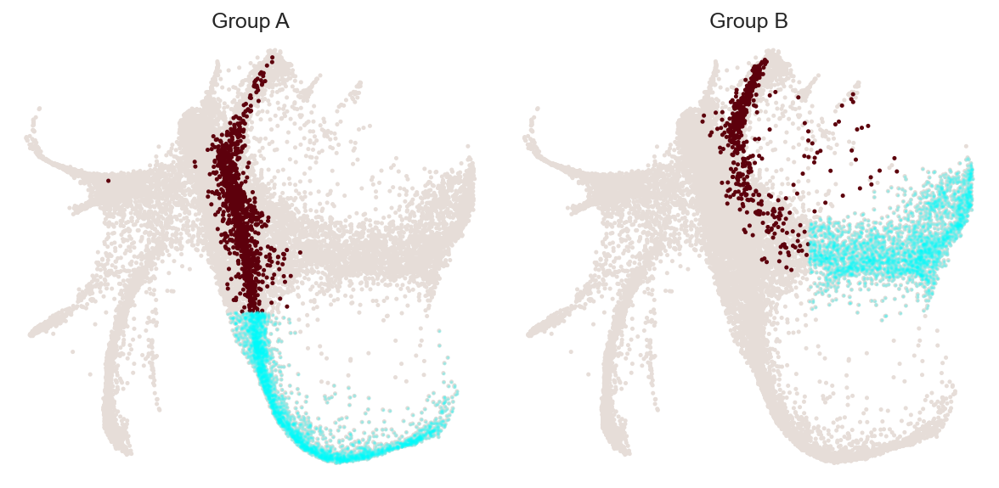

In [24]:
cs.pl.dynamic_trajectory_from_binary_fate_bias(adata, selected_fates=['Neutrophil','Monocyte'], 
 used_Tmap='transition_map', map_backwards=True, 
    bias_threshold=0, sum_fate_prob_thresh=0.2, avoid_target_states=True)

From `OT_transition_map`. We change sum_fate_prob_thresh=0.3 to get rid of low-probability states.

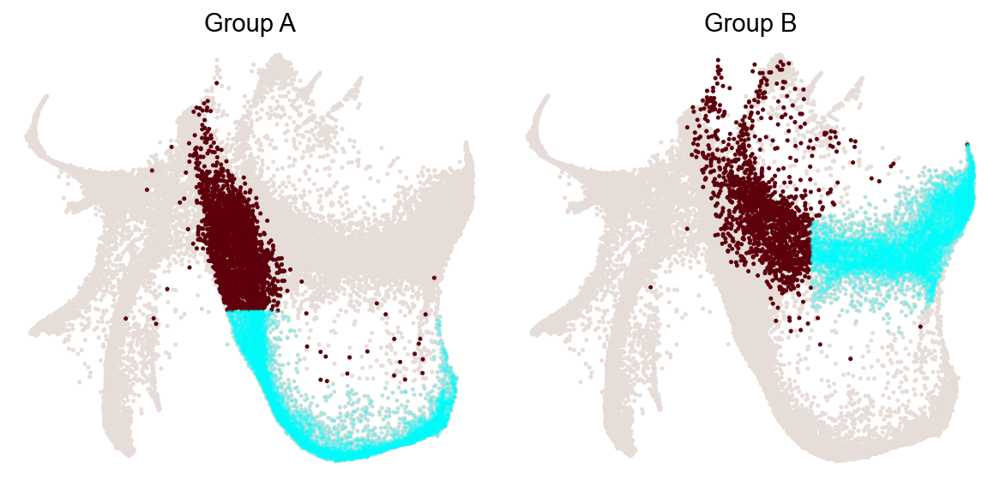

In [34]:
cs.pl.dynamic_trajectory_from_binary_fate_bias(adata, selected_fates=['Neutrophil','Monocyte'], 
 used_Tmap='OT_transition_map', map_backwards=True, 
    bias_threshold=0, sum_fate_prob_thresh=0.3, avoid_target_states=True)

We can see that the `OT_transition_map`, which is constructed using the shortest path distance 
(not WOT map that uses gene expression distance), still has the potential to recover the ealy 
fate bias boundary, although the boundary is much more blurry than what coherent sparsity 
optimization would predicted.

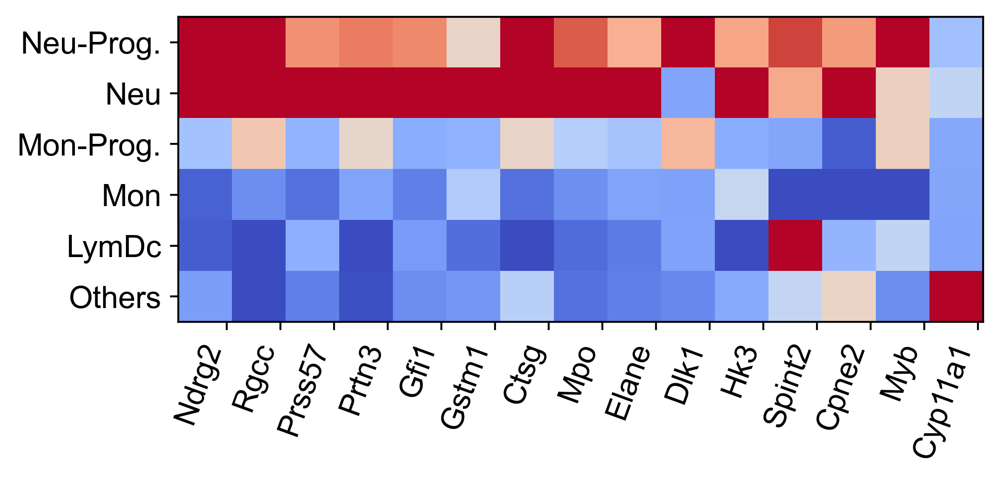

In [18]:
state_info=np.array(adata.obs['state_info'])
cell_group_A=adata.obs['cell_group_A']
state_info[cell_group_A]='Neu_Prog'
cell_group_B=adata.obs['cell_group_B']
state_info[cell_group_B]='Mon_Prog'
gene_list=['Ndrg2','Rgcc','Prss57','Prtn3','Gfi1','Gstm1','Ctsg','Mpo','Elane','Dlk1','Hk3','Spint2','Cpne2','Myb','Cyp11a1']
#gene_list=['Ndrg2','Rgcc','Prss57','Hk3','Spint2','Cpne2']

selected_fates=['Neu_Prog','Neutrophil','Mon_Prog','Monocyte',['pDC','Ccr7_DC','Lymphoid'],['Baso','Eos','Erythroid','Mast','Meg']]
renames=['Neu-Prog.','Neu','Mon-Prog.','Mon','LymDc','Others']
gene_expression_matrix=cs.hf.gene_expression_heat_map(adata, state_info, gene_list,selected_fates,rename_selected_fates=renames,vmax=1,vmin=-1)



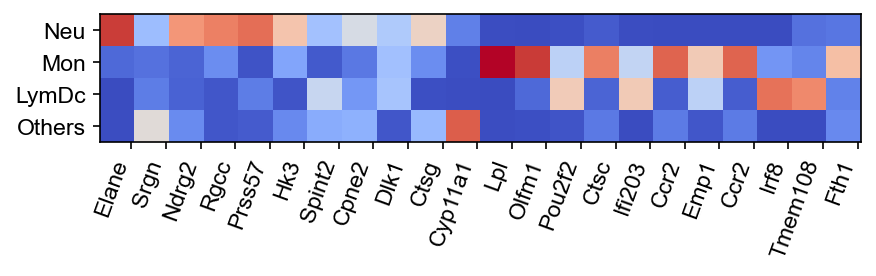

In [44]:
cs.settings.set_figure_params(format='pdf',figsize=[5,2],dpi=75,fontsize=12,pointsize=3) 

state_info=np.array(adata.obs['state_info'])
cell_group_A=adata.obs['cell_group_A']
state_info[cell_group_A]='Neu_Prog'
cell_group_B=adata.obs['cell_group_B']
state_info[cell_group_B]='Mon_Prog'
# gene_list=['Srgn','Ndrg2','Rgcc','Prss57','Prtn3','Gfi1','Gstm1','Ctsg','Mpo','Elane','Dlk1','Hk3','Spint2','Cpne2','Myb','Cyp11a1','Lpl','Spp1','Psap','Ly6a','Ctsc','Ifi203','Mmp8','Fth1','Ccr2','Pou2f2',
#            'Cd74','Casp6','Olfm1','Mrc1','H2-Eb1','Wfdc17','Il6st','Fabp5','Dab2','Emp1','Irf8','Tmem108']
gene_list=['Elane','Srgn','Ndrg2','Rgcc','Prss57','Hk3','Spint2','Cpne2','Dlk1','Ctsg','Cyp11a1',
           'Lpl','Olfm1','Pou2f2','Ctsc','Ifi203','Ccr2','Emp1','Ccr2','Irf8','Tmem108','Fth1']

#gene_list=['Lpl','Psap','Ctsc','Ifi203','Ccr2','Olfm1','Emp1']
#gene_list=['Lpl','Ctsc','Ifi203','Ccr2','Olfm1','Emp1']
# selected_fates=['Neu_Prog','Neutrophil','Mon_Prog','Monocyte',['pDC','Ccr7_DC','Lymphoid'],['Baso','Eos','Erythroid','Mast','Meg']]
# renames=['Neu-Prog.','Neu','Mon-Prog.','Mon','LymDc','Others']
# selected_fates=['Neu_Prog','Mon_Prog']
# renames=['Neu prog.','Mon prog.']

selected_fates=['Neutrophil','Monocyte',['pDC','Ccr7_DC','Lymphoid'],['Baso','Eos','Erythroid','Mast','Meg']]
renames=['Neu','Mon','LymDc','Others']

gene_expression_matrix=cs.hf.gene_expression_heat_map(adata, state_info, gene_list,selected_fates,rename_selected_fates=renames,fig_width=6,fig_height=2,method='others')


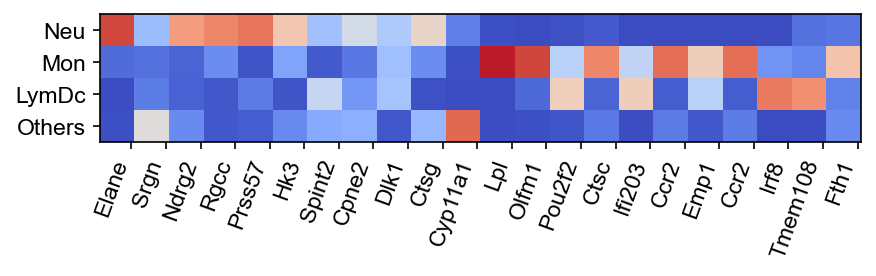

In [46]:
gene_expression_matrix=cs.hf.gene_expression_heat_map(adata, state_info, gene_list,selected_fates,rename_selected_fates=renames,fig_width=6,fig_height=2,method='others',vmax=1,vmin=0)


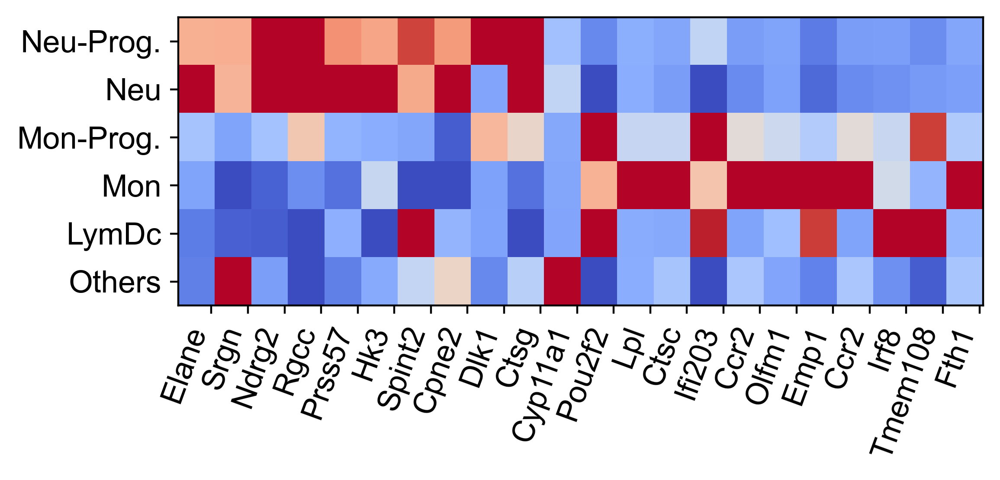

In [41]:
cs.settings.set_figure_params(format='pdf',figsize=[4,3.5],dpi=200,fontsize=14,pointsize=3) 

state_info=np.array(adata.obs['state_info'])
cell_group_A=adata.obs['cell_group_A']
state_info[cell_group_A]='Neu_Prog'
cell_group_B=adata.obs['cell_group_B']
state_info[cell_group_B]='Mon_Prog'
gene_list=['Elane','Srgn','Ndrg2','Rgcc','Prss57','Hk3','Spint2','Cpne2','Dlk1','Ctsg','Cyp11a1',
           'Pou2f2','Lpl','Ctsc','Ifi203','Ccr2','Olfm1','Emp1','Ccr2','Irf8','Tmem108','Fth1']
selected_fates=['Neu_Prog','Neutrophil','Mon_Prog','Monocyte',['pDC','Ccr7_DC','Lymphoid'],['Baso','Eos','Erythroid','Mast','Meg']]
renames=['Neu-Prog.','Neu','Mon-Prog.','Mon','LymDc','Others']
gene_expression_matrix=cs.hf.gene_expression_heat_map(adata, state_info, gene_list,selected_fates,
            rename_selected_fates=renames,color_bar=False,vmax=1,vmin=-1)

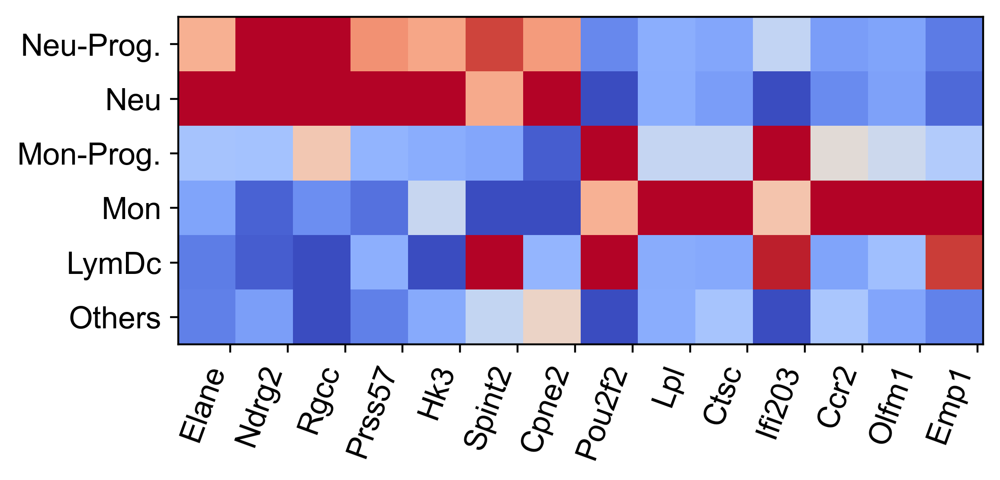

In [14]:
# np.savez(f'{cs.settings.data_path}/gene_exp_heat_map_reprog_full.npz',
#         gene_expression_matrix=gene_expression_matrix,gene_list=gene_list,cluster_name=renames)

data=np.load(f'{cs.settings.data_path}/gene_exp_heat_map_reprog_full.npz',allow_pickle=True)
gene_expression_matrix=data['gene_expression_matrix']
gene_list=data['gene_list']
cluster_name=data['cluster_name']

cs.hf.heatmap_v1(cs.settings.figure_path, gene_expression_matrix, gene_list,cluster_name,int_seed=10,
        data_des='',log_transform=False,color_map=plt.cm.coolwarm,fig_width=6,fig_height=3,
        color_bar=False,vmin=-1,vmax=1)

In [25]:
dge_gene_A.loc[:200].to_csv(f'{cs.settings.data_path}/LARRY_full_diff_MonNeuProgenitor_Neu_biased.csv')
dge_gene_B.loc[:200].to_csv(f'{cs.settings.data_path}/LARRY_full_diff_MonNeuProgenitor_Mon_biased.csv')

## Part IV: Predict early fate bias on day 3

### Load data

In [46]:
adata_orig_1=cs.hf.read(f'CellTag_data_full/Reprog_128_D0D3_adata_preprocessed.h5ad')
cs.settings.data_path='CellTag_data_full' # A relative path to save data. If not existed before, create a new one.
cs.settings.figure_path='CellTag_figure_full' # A relative path to save figures. If not existed before, create a new one.
adata_orig_1.uns['data_des']=['Reprog_128']

In [4]:
adata_orig_1=cs.pp.initialize_adata_object(adata_orig_1)

Clones without any cells are removed.
Time points with clonal info: ['Day28']


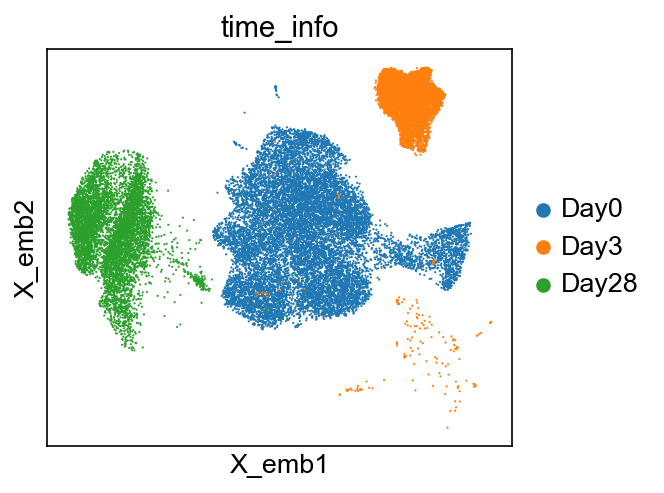

<Figure size 450x300 with 0 Axes>

In [5]:
cs.pl.embedding(adata_orig_1,color='time_info')

In [6]:
adata_orig_1

AnnData object with n_obs × n_vars = 27718 × 28001
    obs: 'Day', 'predicted_doublet', 'leiden', 'row_counts', 'time_info', 'state_info', 'batch', 'cell_group_A', 'cell_group_B', 'state_info_1'
    var: 'highly_variable-0'
    uns: 'Day_colors', 'clonal_time_points', 'data_des', 'dynamic_trajectory', 'fate_map_output', 'neighbors', 'sp_idx', 'state_info_1_colors', 'state_info_colors', 'time_info_colors', 'time_ordering'
    obsm: 'X_clone', 'X_emb', 'X_emb_old', 'X_emb_v1', 'X_pca'
    obsp: 'connectivities', 'distances'

In [8]:
cs.hf.save_preprocessed_adata(adata_orig_1)

Saved file: CellTag_data_full/Reprog_128_adata_preprocessed.h5ad


### Infer transition map from end-point clones¶

In [12]:
adata_1=cs.tmap.infer_Tmap_from_one_time_clones(adata_orig_1,initial_time_points=['Day3'],
    later_time_point=['Day28'],initialize_method='HighVar',smooth_array=[15,10,5], 
                        max_iter_N=[1,3],sparsity_threshold=0.2,use_full_Smatrix=True)

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


--------Infer transition map between initial time points and the later time one-------
--------Current initial time point: Day3--------
Step 0: Pre-processing and sub-sampling cells-------
Step 1: Use the HighVar method for initialization-------
Step a: find the commonly shared highly variable genes------
Highly varable gene number: 1684 (t1); 1696 (t2). Common set: 960
Step b: convert the shared highly variable genes into clonal info------
Total used genes=889 (no cells left)
Step c: compute the transition map based on clonal info from highly variable genes------
Load pre-computed similarity matrix
Iteration 1, Use smooth_round=15
Iteration 2, Use smooth_round=10
Iteration 3, Use smooth_round=5
Convergence (CoSpar, iter_N=3): corr(previous_T, current_T)=0.884
Finishing initialization using HighVar, used time 168.18585419654846
Step 2: Jointly optimize the transition map and the initial clonal states-------
-----JointOpt Iteration 1: Infer initial clonal structure
-----JointOpt Iterati

### Fate bias

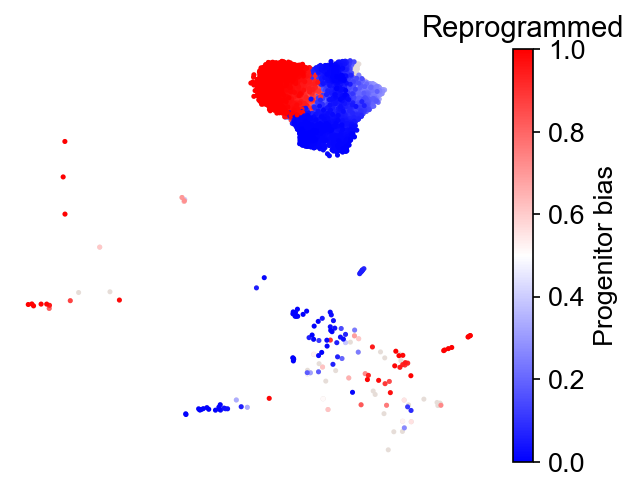

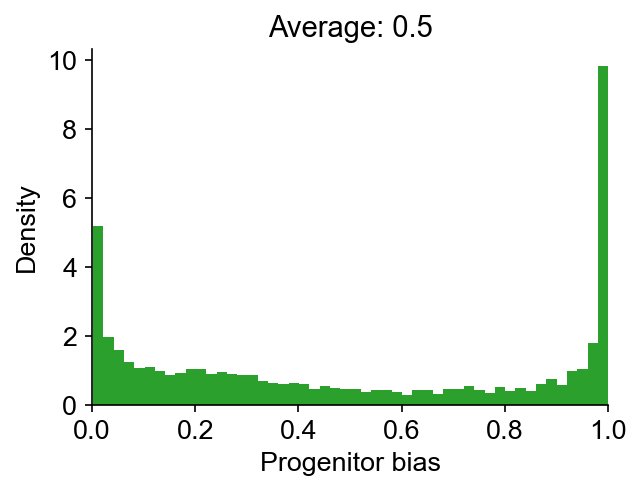

In [13]:
cs.pl.fate_bias(adata_1,selected_fates=['Reprogrammed','Failed'],used_Tmap='transition_map',
            selected_times=['Day3'],plot_target_state=False,map_backward=True,sum_fate_prob_thresh=0.1)

### Identify ancestor populations

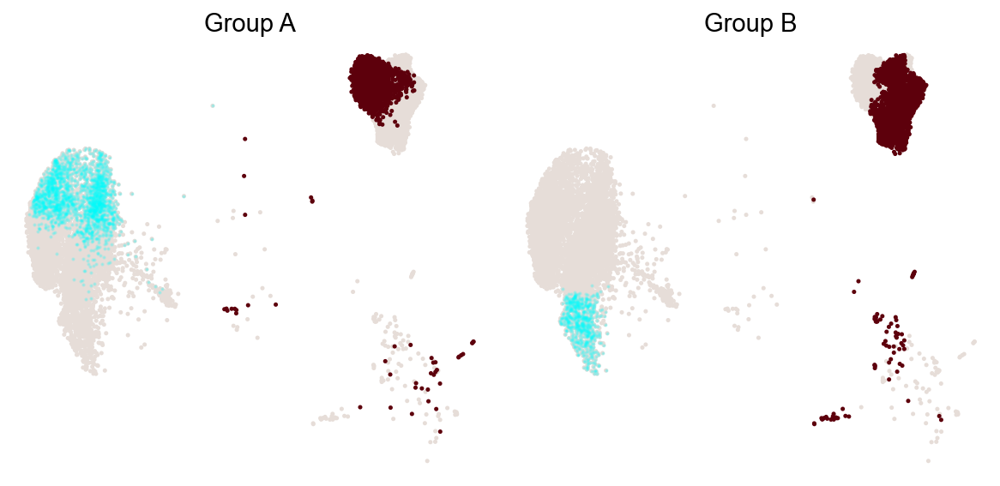

In [14]:
cs.pl.dynamic_trajectory_from_fate_bias(adata_1, selected_fates=['Reprogrammed','Failed'], 
 used_Tmap='transition_map', map_backward=True, selected_times=None,method='norm-sum',
    bias_threshold_A=0.5,bias_threshold_B=0.5, sum_fate_prob_thresh=0.2, avoid_target_states=False)


### DGE analysis

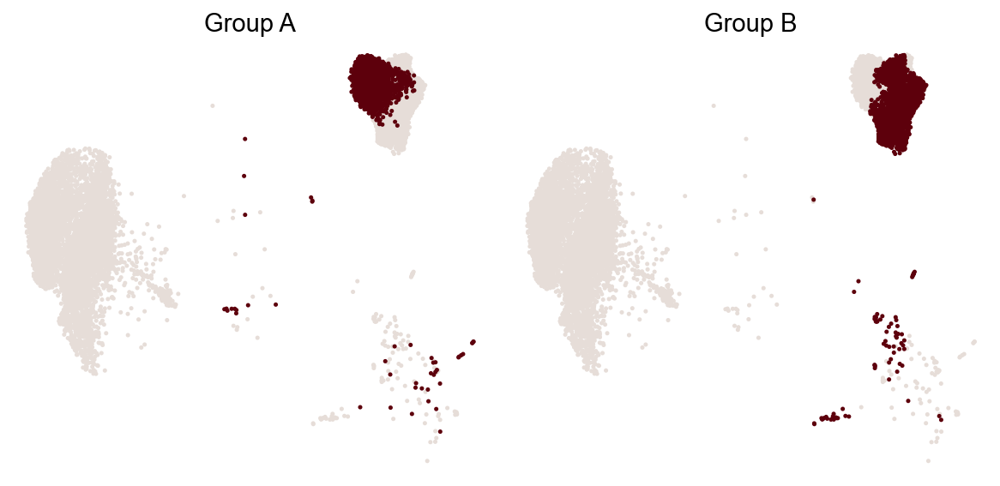

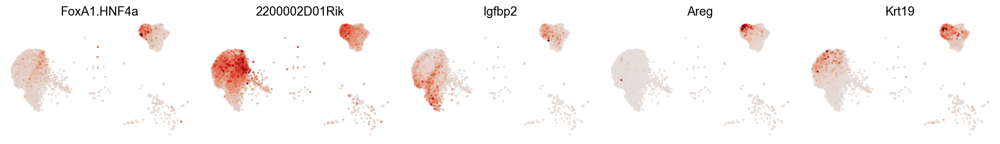

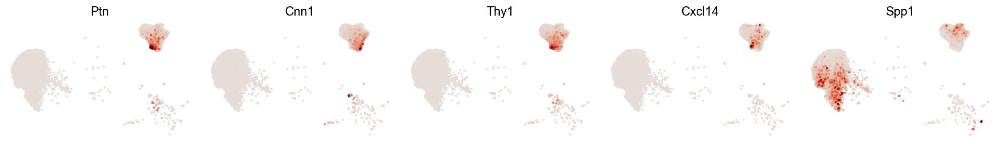

In [19]:
dge_gene_A, dge_gene_B=cs.pl.differential_genes(adata_1,plot_gene_N=5)

In [20]:
# All, ranked, DGE genes for group A
dge_gene_A

,index,gene,Qvalue,mean_1,mean_2,ratio
0,0,FoxA1.HNF4a,0.000000e+00,1.783575,8.132658,-1.714096
1,3,2200002D01Rik,0.000000e+00,5.032273,12.752265,-1.188896
2,88,Igfbp2,1.998750e-77,1.216059,3.971929,-1.165809
3,63,Areg,2.021537e-91,0.282244,1.619240,-1.030477
4,49,Krt19,3.152341e-111,0.706120,2.467072,-1.022998
...,...,...,...,...,...,...
1972,3374,Rpl11,4.464113e-02,15.020033,15.323122,-0.027040
1973,2463,S100a11,4.161390e-03,13.435087,13.703053,-0.026536
1974,3135,Lgals3,2.692391e-02,1.673561,1.720893,-0.025318
1975,3302,Atp5h,3.858812e-02,2.684252,2.747064,-0.024389


Update cluster annotation on day 3

... storing 'state_info' as categorical


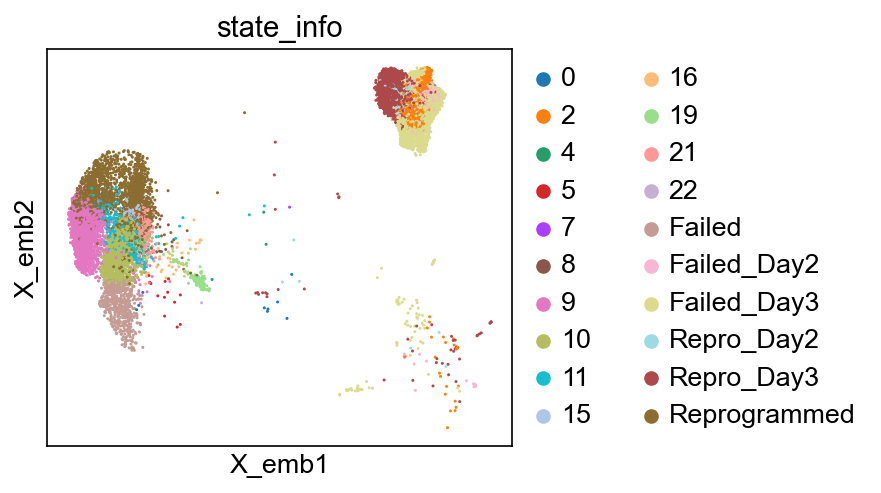

<Figure size 450x300 with 0 Axes>

In [21]:
cell_group_A=np.array(adata_1.obs['cell_group_A'])
cell_group_B=np.array(adata_1.obs['cell_group_B'])

x_emb=adata_1.obsm['X_emb'][:,0]
state_info=np.array(adata_1.obs['state_info']).astype('>U15')
sp_idx=cell_group_A & (x_emb>0)
state_info[sp_idx]='Repro_Day3'

sp_idx=cell_group_B & (x_emb>0)
state_info[sp_idx]='Failed_Day3'
adata_1.obs['state_info']=state_info
cs.pl.embedding(adata_1,color='state_info')

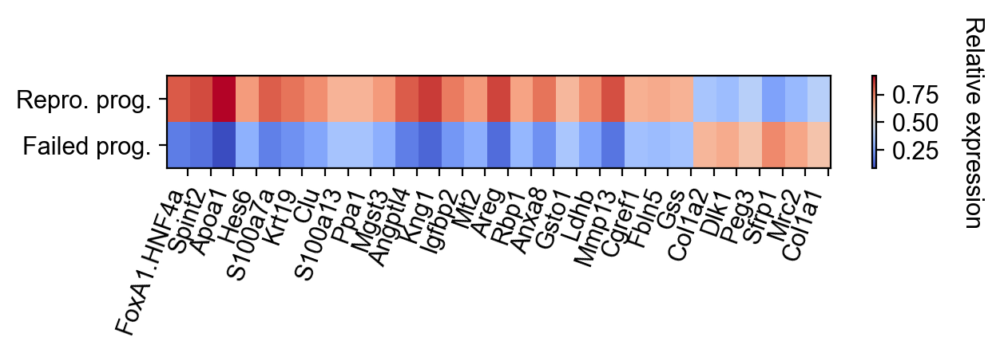

In [23]:
cs.settings.set_figure_params(fontsize=12)
state_info=np.array(adata_1.obs['state_info'])
gene_list=['FoxA1.HNF4a','Spint2','Apoa1', 'Hes6', 'S100a7a', 'Krt19',  'Clu',  'S100a13',
        'Ppa1', 'Mgst3',  'Angptl4','Kng1','Igfbp2','Mt2','Areg','Rbp1','Anxa8','Gsto1','Ldhb','Mmp13','Cgref1','Fbln5','Gss','Col1a2','Dlk1','Peg3','Sfrp1','Mrc2','Col1a1']

selected_fates=['Repro_Day3','Failed_Day3']
renames=['Repro. prog.','Failed prog.']

gene_expression_matrix=cs.pl.gene_expression_heat_map(adata_1,selected_genes=gene_list,
            selected_fates=selected_fates,rename_fates=renames,horizontal=True,fig_width=6.5,fig_height=2)

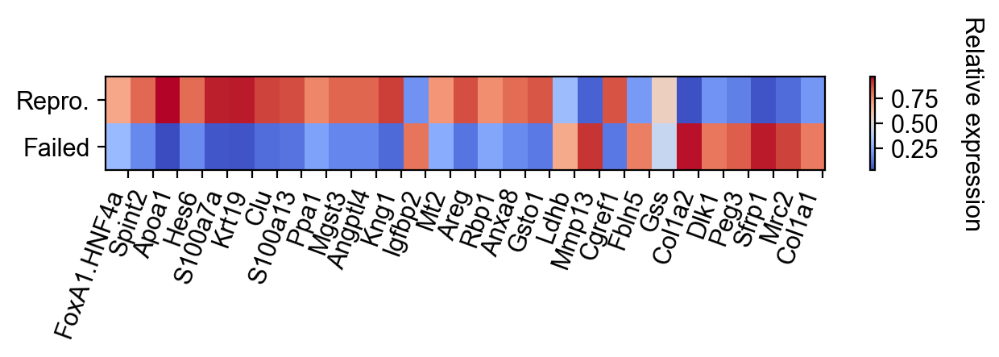

In [24]:
state_info=np.array(adata_1.obs['state_info'])
gene_list=['FoxA1.HNF4a','Spint2','Apoa1', 'Hes6', 'S100a7a', 'Krt19',  'Clu',  'S100a13',
        'Ppa1', 'Mgst3',  'Angptl4','Kng1','Igfbp2','Mt2','Areg','Rbp1','Anxa8','Gsto1','Ldhb','Mmp13','Cgref1','Fbln5','Gss','Col1a2','Dlk1','Peg3','Sfrp1','Mrc2','Col1a1']

selected_fates=['Reprogrammed','Failed']
renames=['Repro.','Failed']

gene_expression_matrix=cs.pl.gene_expression_heat_map(adata_1,selected_genes=gene_list,
            selected_fates=selected_fates,rename_fates=renames,horizontal=True,fig_width=6.5,fig_height=2)